In [1]:
%matplotlib inline

In [2]:
import pulp
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

import pandas as pd
import numpy as np
from random import shuffle
from mpl_toolkits.mplot3d import Axes3D

In [3]:
# Hyper Parameters
LR = 0.2                   # learning rate
EPSILON = 0.7               # greedy policy
GAMMA = 0.9                 # reward discount
LAMBDA = 0.9                # parameter decay

N_ACTIONS = 10 #no. of duty cycles (0,1,2,3,...,10)
BMIN = 0.0
BMAX = 20000.0 #Battery capacity
BOPT = 0.6 * BMAX #Assuming 60% of battery is the optimal level
HMAX = 1000
DMAX = 500
DMIN = 100

In [4]:
class ENO(object):
    def __init__(self, year=2010):
        self.year = year
        self.day = None
        self.hr = None
        
        self.TIME_STEPS = None
        self.NO_OF_DAYS = None
        
        self.BMIN = BMIN
        self.BMAX = BMAX #Battery capacity
        self.BOPT = 0.6 * self.BMAX #Assuming 60% of battery is the optimal level
        self.HMAX = HMAX
        
        self.senergy = None #matrix with harvested energy data for the entire year
        self.fforecast = None #matrix with forecast values for each day
        
        self.batt = None #battery variable
        self.enp = None #enp at end of hr
        self.henergy = None #harvested energy variable
        self.fcast = None #forecast variable
    
    #function to map total day energy into day_state
    def get_day_state(self,tot_day_energy):
        if (tot_day_energy < 2500):
            day_state = 0
        elif (2500 <= tot_day_energy < 5000):
            day_state = 1
        elif (5000 <= tot_day_energy < 8000):
            day_state = 2
        elif (8000 <= tot_day_energy < 10000):
            day_state = 3
        elif (10000 <= tot_day_energy < 12000):
            day_state = 4
        else:
            day_state = 5
        return int(day_state)

    #function to get the solar data for the given year and prep it
    def get_data(self):
        filename = str(self.year)+'.csv'
        #skiprows=4 to remove unnecessary title texts
        #usecols=4 to read only the Global Solar Radiation (GSR) values
        solar_radiation = pd.read_csv(filename, skiprows=4, encoding='shift_jisx0213', usecols=[4])
        
        #convert dataframe to numpy array
        solar_radiation = solar_radiation.values
        solar_energy = np.array([i *0.0165*1000000*0.15*1000/(60*60) for i in solar_radiation])
        
        #reshape solar_energy into no_of_daysx24 array
        _senergy = solar_energy.reshape(-1,24)
        _senergy[np.isnan(_senergy)] = 0 #convert missing data in CSV files to zero
        self.senergy = np.clip(_senergy,0,self.HMAX) #limit the amount of harvested energy to HMAX        
        
        #create a perfect forecaster
        tot_day_energy = np.sum(_senergy, axis=1) #contains total energy harvested on each day
        get_day_state = np.vectorize(self.get_day_state)
        self.fforecast = get_day_state(tot_day_energy)
        
        return 0
    
    def reset(self):
        
        self.get_data() #first get data for the given year
        
        self.TIME_STEPS = self.senergy.shape[1]
        self.NO_OF_DAYS = self.senergy.shape[0]
        
        print("Environment is RESET")
        
        self.day = 0
        self.hr = 0
        
        self.batt = self.BOPT #battery returns to optimal level
        self.enp = self.BOPT - self.batt #enp is reset to zero
        self.henergy = self.senergy[self.day][self.hr] 
        self.fcast = self.fforecast[self.day]
        
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5

        state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
        reward = 0
        done = False
        info = "RESET"
        return [state, reward, done, info]
    
    
    #reward function
    def rewardfn(self):
        mu = 0
        sig = 1000
        norm_enp = self.enp/(self.BMAX/2)
        if(np.abs(norm_enp) <= DMIN*self.TIME_STEPS/(BMAX/2)): # DMIN*self.TIME_STEPS/(BMAX/2) - normalized value of worst case power consumption at min duty cycle
            return ((1./(np.sqrt(2.*np.pi)*sig)*np.exp(-np.power((self.enp - mu)/sig, 2.)/2)) * 1E6)
        else:
            return -100 - 0.05*np.abs(self.enp)
    
    def step(self, action):
        done = False
        info = "OK"
        reward = 0
        e_consumed = (action+1)*DMAX/N_ACTIONS
        
        self.batt += (self.henergy - e_consumed)
        self.batt = np.clip(self.batt, self.BMIN, self.BMAX)
        self.enp = self.BOPT - self.batt
        
        if(self.hr < self.TIME_STEPS - 1):
            self.hr += 1
            self.henergy = self.senergy[self.day][self.hr] 
        else:
            if(self.day < self.NO_OF_DAYS -1):
                reward = self.rewardfn() #give reward only at the end of the day
                self.hr = 0
                self.day += 1
                self.henergy = self.senergy[self.day][self.hr] 
                self.fcast = self.fforecast[self.day]
            else:
                reward = self.rewardfn()
                done = True
                info = "End of the year"
        
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5

        _state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
        return [_state, reward, done, info]
                
        #we normalize the enp w.r.t. half of the battery level
        #this may give weird results if BOPT varies by a great amount from 0.5*BMAX
    
    def getstate(self):
        norm_batt = self.batt/self.BMAX
        norm_enp = self.enp/(self.BMAX/2)
        norm_henergy = self.henergy/self.HMAX
        norm_fcast = self.fcast/5
        state = [norm_batt, norm_enp, norm_henergy, norm_fcast]
               
        return state

In [5]:
class SARSA(object):
    def __init__(self):
        self.no_of_batt_state = 3;
        self.no_of_enp_state = 42;
        self.no_of_henergy_state = 30;
        self.no_of_day_state = 6;
        self.no_of_actions = N_ACTIONS;
        self.q_init = 200;
        self.q = np.zeros((self.no_of_batt_state, self.no_of_enp_state, self.no_of_henergy_state, self.no_of_day_state, self.no_of_actions)) + self.q_init
        self.e = np.zeros_like(self.q)

    
    def get_batt_state(self,batt):
        if (batt < 0.3):
            batt_state = 0
        elif (0.3<= batt <0.8):
            batt_state = 1
        else:
            batt_state = 2
        
        return int(batt_state)
    
    def get_enp_state(self,enp):
        #assuming the battery deviates equally in both enp directions
        #NEEDS TO BE RETHOUGHT AND UPDATED
#         enp_max = 0.5
#         enp_min = 0
        
        enp = np.clip(enp,-0.5,0.5)
        _enp = 0.5 + enp
        enp_state = np.ceil(_enp*self.no_of_enp_state)
        
        enp_state = np.clip(enp_state, 0, self.no_of_enp_state-1)
        return int(enp_state)
    
    def get_henergy_state(self,henergy):
        henergy_state = int(np.floor(henergy*self.no_of_henergy_state))
        henergy_state = np.clip(henergy_state, 0, self.no_of_henergy_state-1)
        return int(henergy_state)
    
    def get_fcast_state(self,fcast):
        return fcast * 5
    
    def discretize(self,ps):
        s = np.zeros(4)
        s[0] = self.get_batt_state(ps[0])
        s[1] = self.get_enp_state(ps[1])
        s[2] = self.get_henergy_state(ps[2])
        s[3] = self.get_fcast_state(ps[3])
        return s.astype(int)
        
    def choose_action(self,s):
        [batt_state, enp_state, henergy_state, day_state] = s
        # This is how to choose an action
        q_values = self.q[batt_state, enp_state, henergy_state,  day_state, :]
        max_q_value = np.max(q_values)
        max_action = np.argmax(q_values)
        if (np.random.uniform() < EPSILON) or ((q_values == 0).all()):  # select randomly if exploring or 
                                                                             #if state-action values are ALL zero
            action = np.random.randint(1,N_ACTIONS)
        else:   # act greedy
            action = max_action
        return int(action)
    
    def choose_greedy_action(self,s):
        [batt_state, enp_state, henergy_state, day_state] = s
        # This is how to choose an action
        q_values = self.q[batt_state, enp_state, henergy_state,  day_state, :]
        max_q_value = np.max(q_values)
        max_action = np.argmax(q_values)
        if ((q_values == 0).all()):  #if state-action values are ALL zero
             action = np.random.randint(1,N_ACTIONS)
        else:   # act greedy
            action = max_action
        return int(action)
    
    def learn(self,transition, terminal):
        [s,a,r,s_,a_] = transition
        [batt_state, enp_state, henergy_state, day_state] = s
        [batt_state_, enp_state_, henergy_state_, day_state_] = s_
        
        if (terminal):
            del_ = r - self.q[batt_state, enp_state, henergy_state, day_state, a]
        else:
            del_ = GAMMA*self.q[batt_state_, enp_state_, henergy_state_, day_state_, a_] \
                    - self.q[batt_state, enp_state, henergy_state, day_state, a]
       
        #update eligibility trace and q-table
        self.e[batt_state, enp_state, henergy_state,  day_state, a] += 1
        qerr = LR*del_*self.e
        self.q += qerr #update the entire qtable
        self.e = GAMMA*LAMBDA*self.e #decay eligibility



In [6]:
eno = ENO(2010)
eno.reset()
sarsa = SARSA()

Environment is RESET


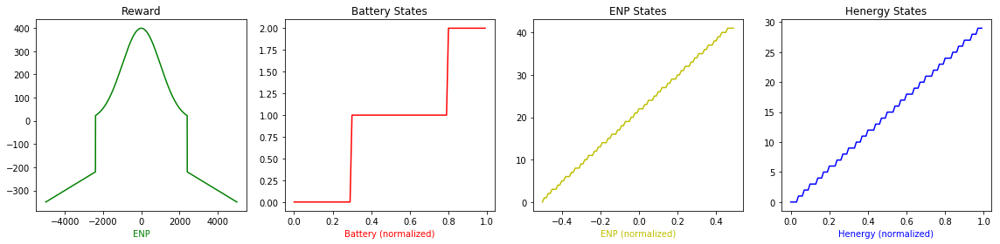

In [7]:
#Check reward function
#ENP varies from -0.5 to 0.5
y1 = np.empty(1)
for x in np.arange(-5000,5000):
    eno.enp = x
    y1 = np.append(y1,eno.rewardfn())
y1 = np.delete(y1, 0, 0) #remove the first row which is garbage

#Check state discretiziation functions
#Battery value varies from 0 to 1
y2 = np.empty(1)
for x in np.arange(0,1,0.01):
    temp = sarsa.get_batt_state(x)
    y2 = np.append(y2,temp)
y2 = np.delete(y2, 0, 0) #remove the first row which is garbage

#Check state discretiziation functions
#ENP value varies from -0.5 to 0.5
#Inconsistent with the reward function 
y3 = np.empty(1)
for x in np.arange(-0.5,0.5,0.01):
    temp = sarsa.get_enp_state(x)
    y3 = np.append(y3,temp)
y3 = np.delete(y3, 0, 0) #remove the first row which is garbage

#Check state discretiziation functions
#henergy value varies from 0 to 1
y4 = np.empty(1)
for x in np.arange(0,1,0.01):
    temp = sarsa.get_henergy_state(x)
    y4 = np.append(y4,temp)
y4 = np.delete(y4, 0, 0) #remove the first row which is garbage


####################################
##   PRINT FIGURES##################
fig = plt.figure(figsize=(16,4))

ax1 = fig.add_subplot(1,4,1)
ax1.set_title("Reward")
ax1.set_xlabel("ENP",color='g')
ax1.plot(np.arange(-5000,5000),y1,'g')

ax2 = fig.add_subplot(1,4,2)
ax2.set_title("Battery States")
ax2.set_xlabel("Battery (normalized)",color='r')
ax2.plot(np.arange(0,1,0.01),y2,'r')

ax3 = fig.add_subplot(1,4,3)
ax3.set_title("ENP States")
ax3.set_xlabel("ENP (normalized)",color='y')
ax3.plot(np.arange(-0.5,0.5,0.01),y3,'y')

ax4 = fig.add_subplot(1,4,4)
ax4.set_title("Henergy States")
ax4.set_xlabel("Henergy (normalized)",color='b')
ax4.plot(np.arange(0,1,0.01),y4,'b')

fig.tight_layout()
plt.show()


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -225.70038596388417


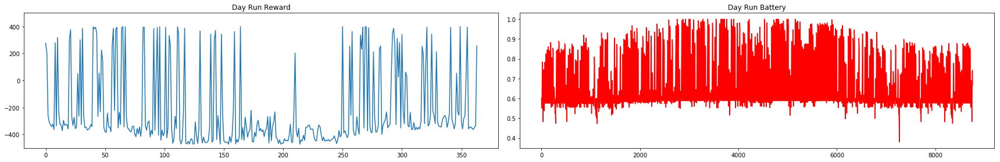


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -217.54762383215336


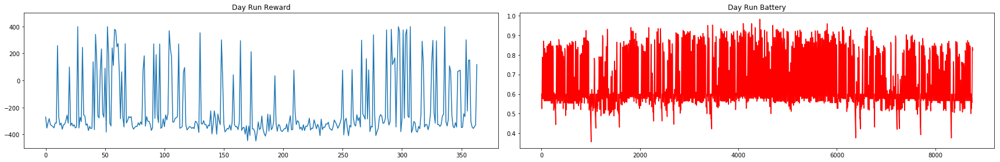


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -135.97345850772575


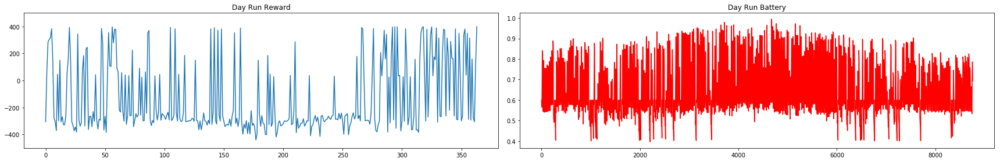


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -147.8573055985408


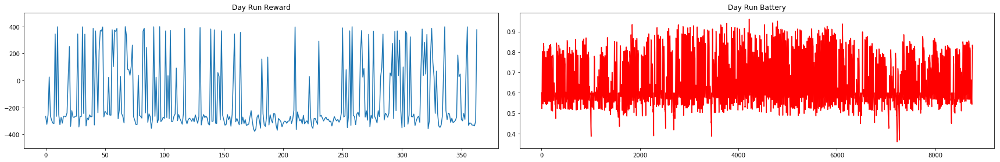


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -1.4839529311164914


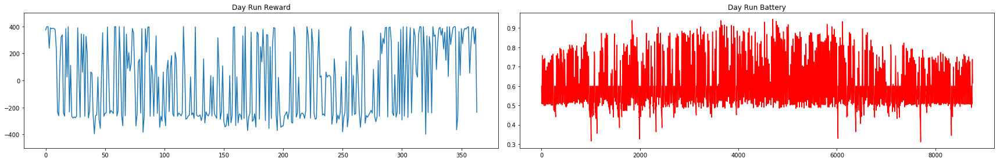


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -105.14276706737179


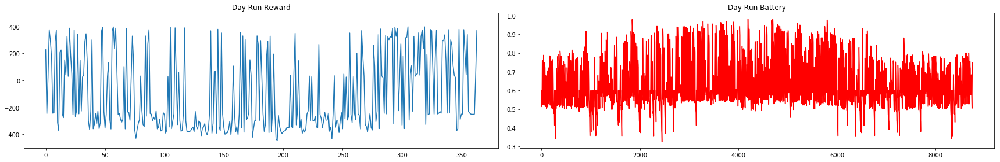


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  12.606921603009345


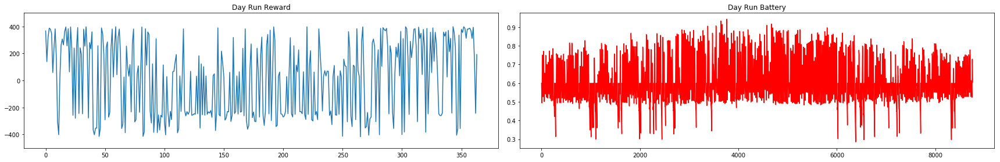


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  -69.60669789782604


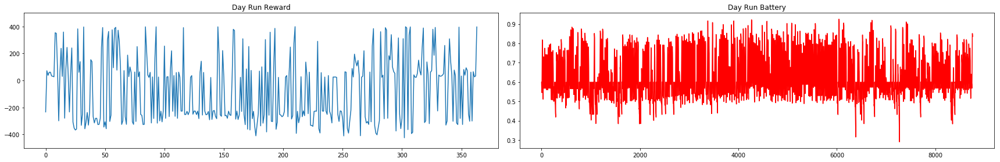


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  31.94147481498666


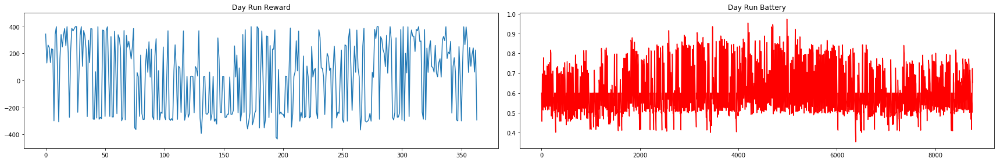


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  7.01656934266882


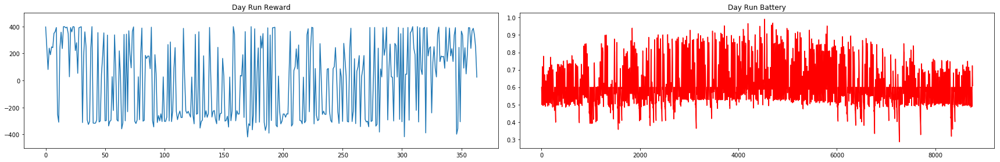


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  105.13829561622035


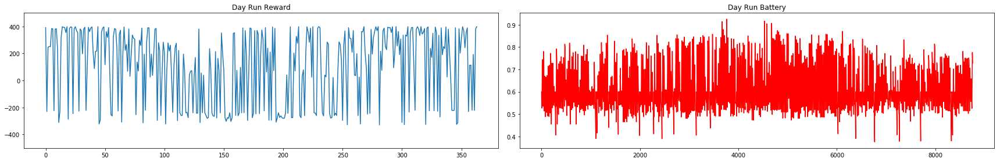


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  155.43729854296615


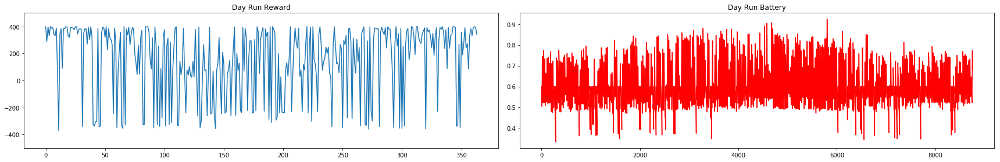


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  79.15263171753178


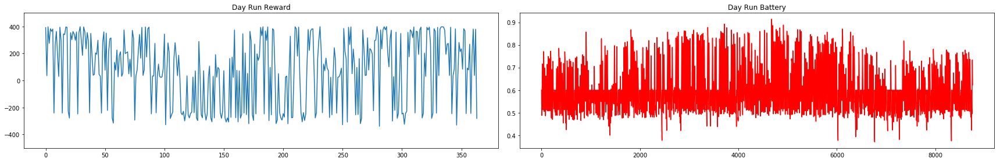


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  71.93904645610618


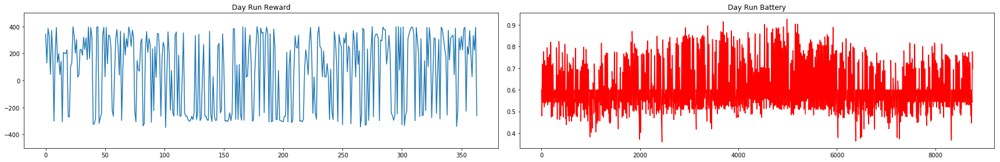


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  78.26613205850602


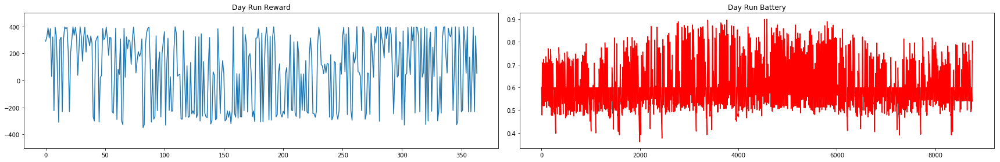


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  103.38740600947396


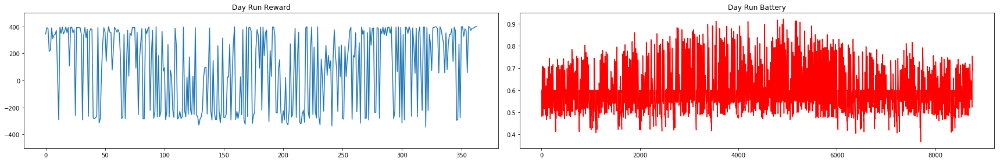


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  54.211926065828024


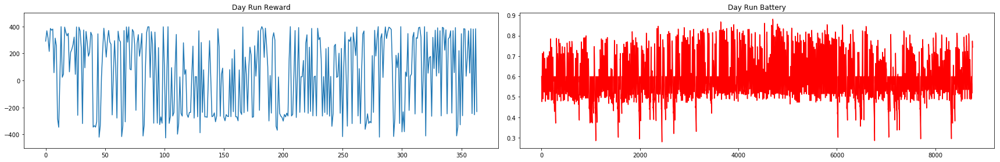


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  84.780463050857


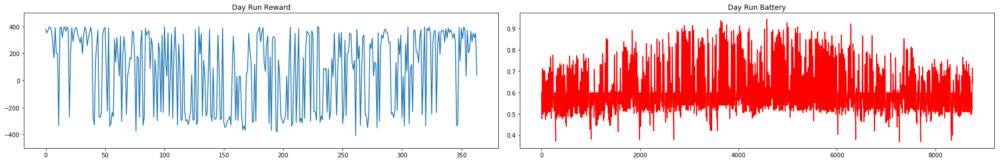


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  92.45800319947946


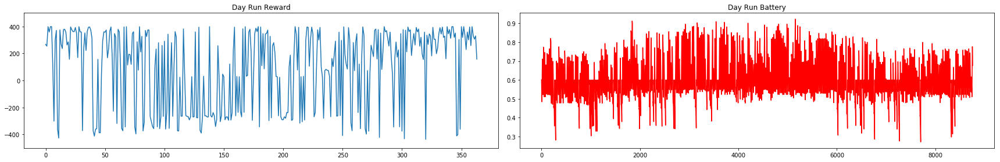


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  35.123315416571174


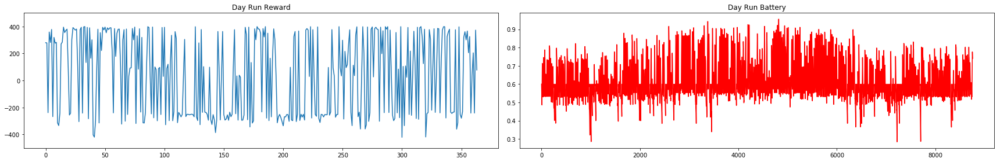


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  125.0955967118753


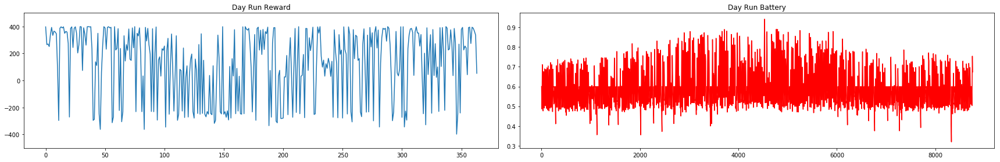


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  106.87905106295591


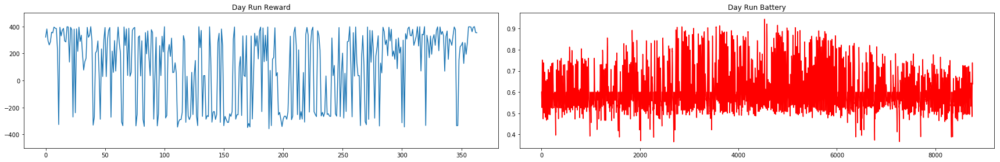


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  59.68925306439729


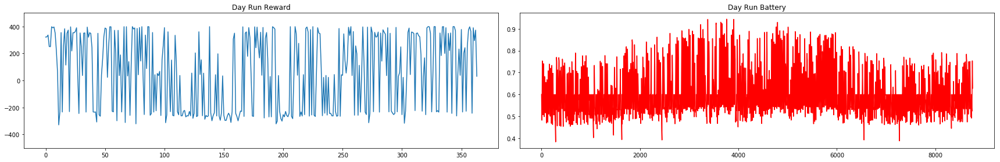


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  131.08332256344764


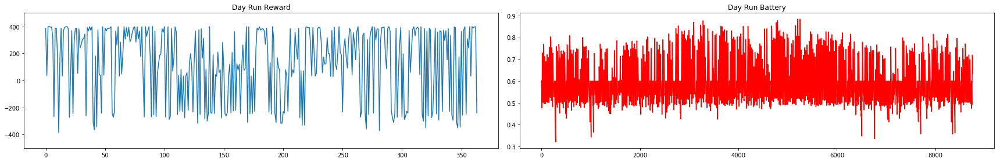


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  167.0105495081147


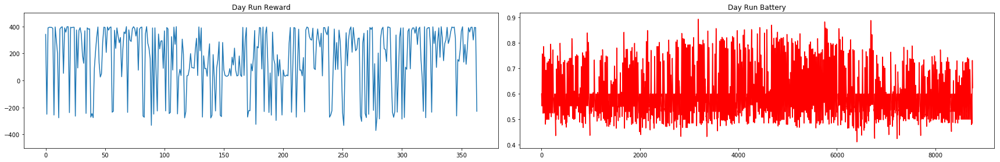


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  83.98642413430673


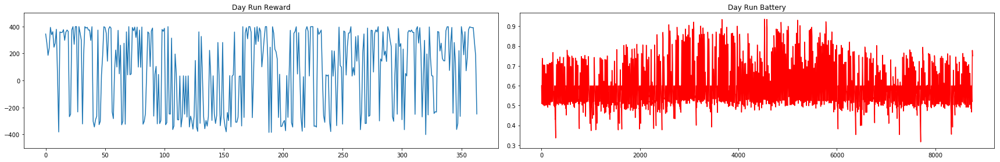


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  39.189985386196135


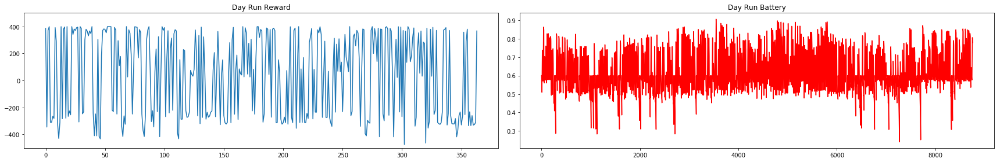


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  70.58105965841786


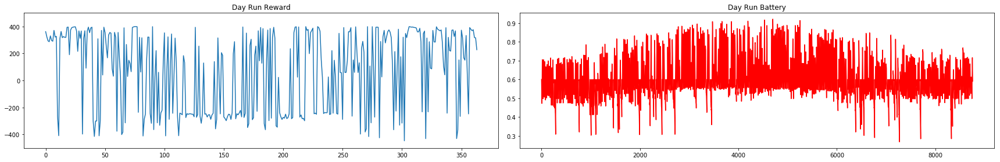


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  86.26846019492936


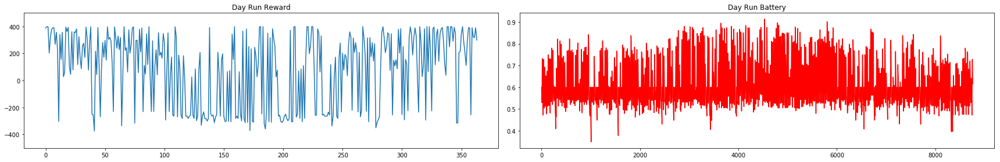


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  79.08882551270955


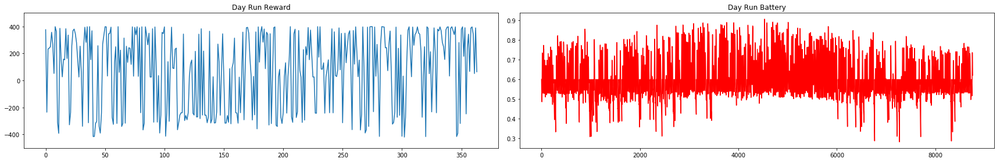


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  43.397582260859046


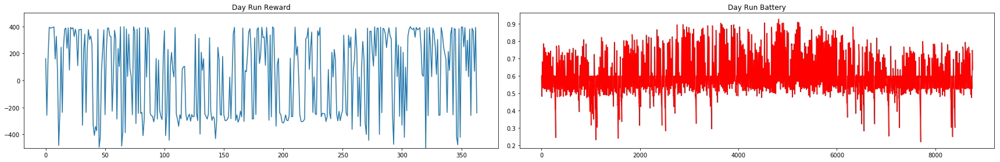


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  86.44256893959307


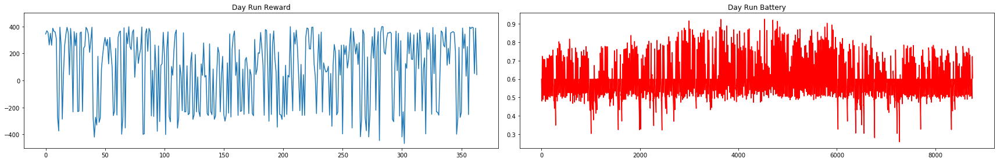


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  162.33920147373664


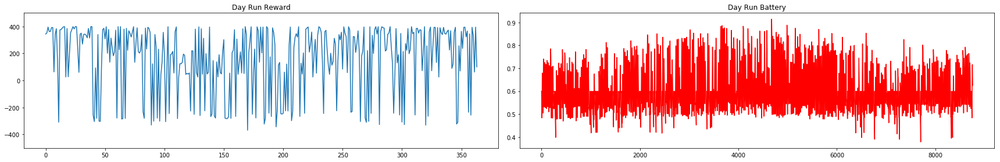


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  125.61081197866626


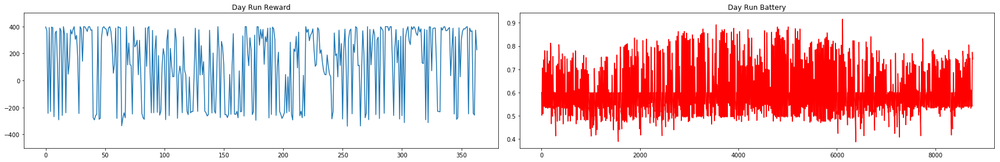


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  140.30739931154343


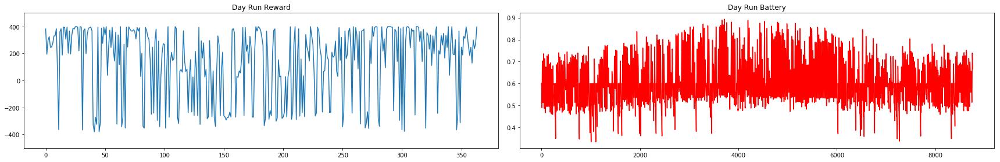


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  124.82822524105586


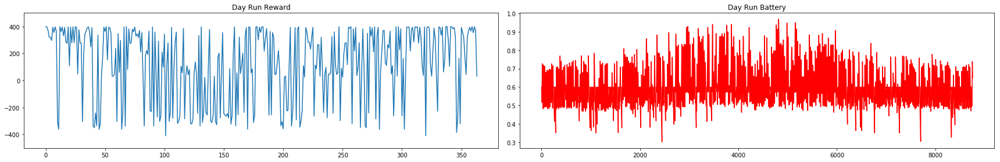


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  83.42435316990709


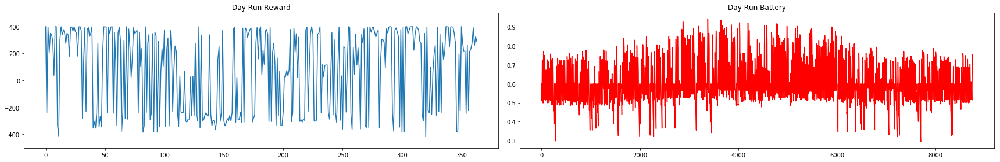


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  97.05703327877157


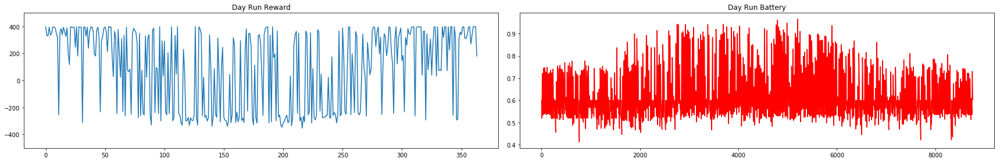


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  102.03225184975682


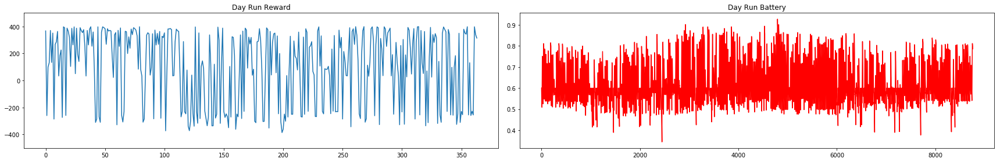


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  118.31152849782166


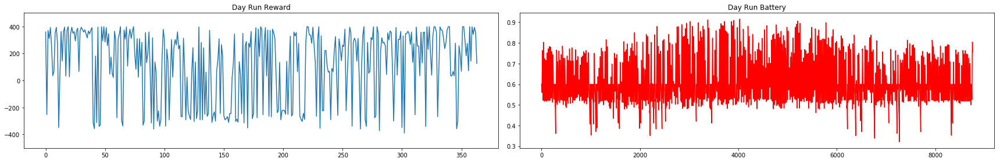


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  106.62965022068882


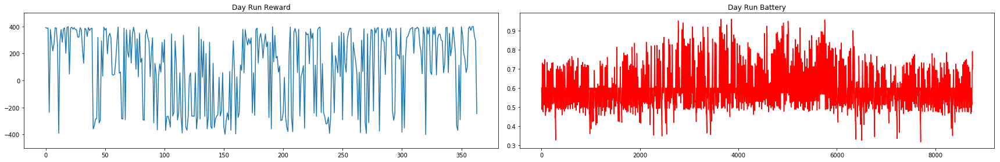


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  145.49863024694616


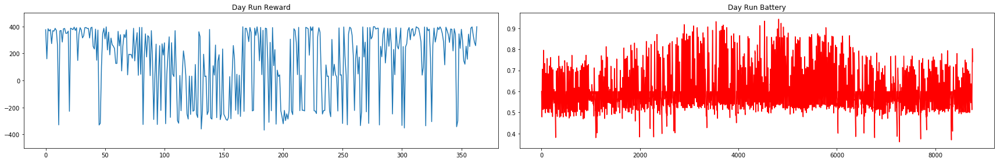


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  70.88882223795109


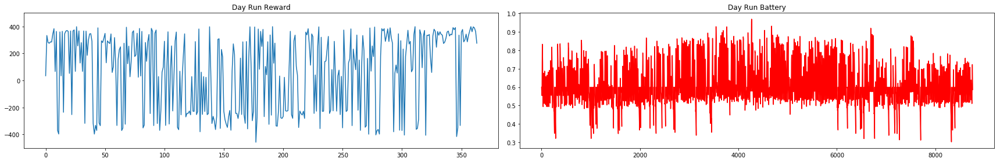


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  68.50086495464186


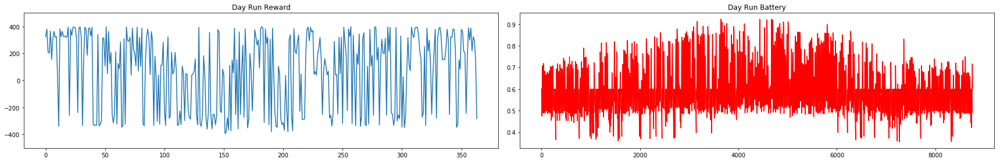


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  147.9795006909196


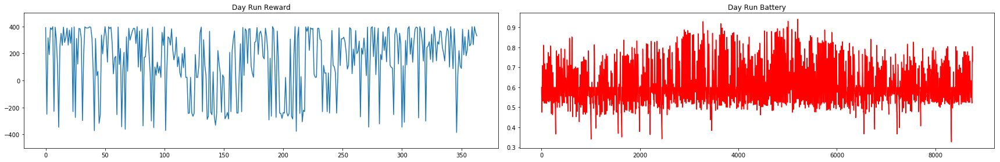


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  99.19435502346971


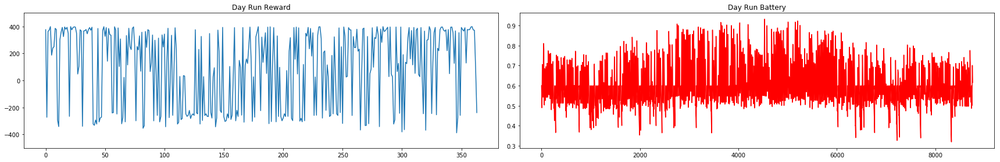


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  93.90552412410015


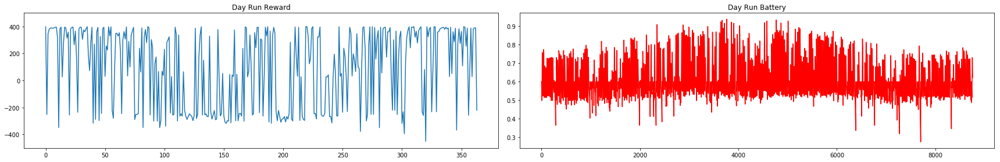


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  153.7228469264068


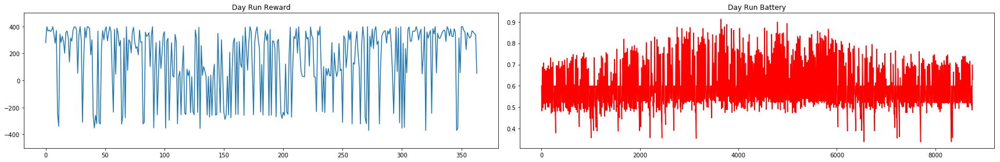


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  126.65574886302022


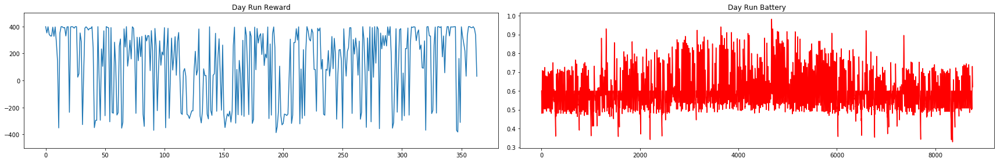


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  165.83653486143766


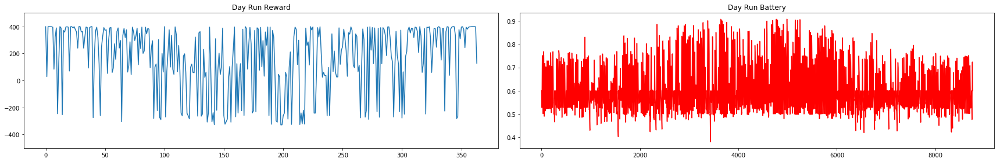


Learning Rate =  0.2
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  72.83976536763888


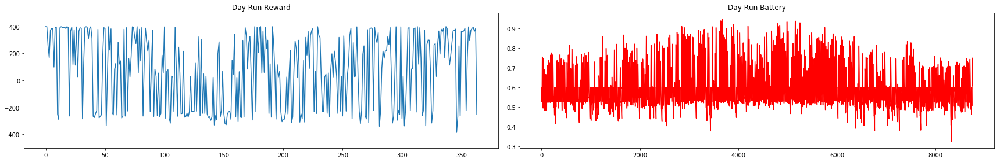


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  91.91208795241212


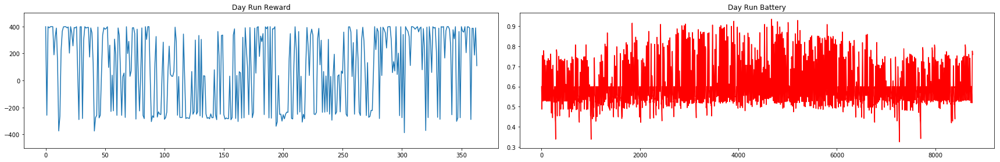


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  145.55472049149301


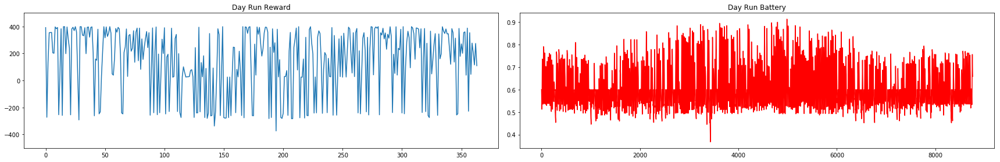


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  182.8794405204629


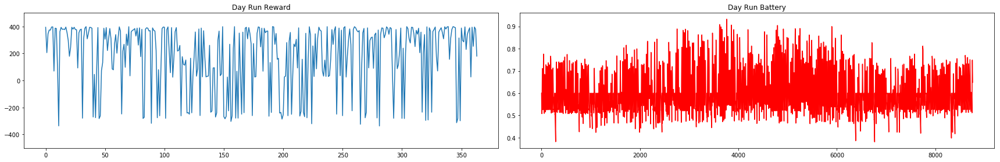


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  165.40307402315088


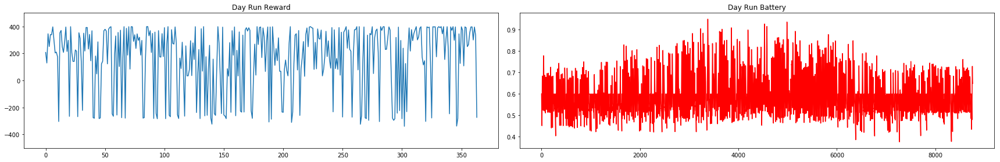


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  131.661260186833


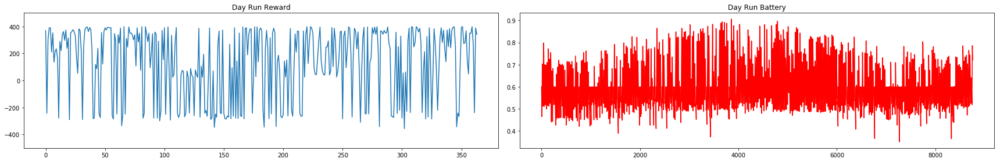


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  118.33994548842988


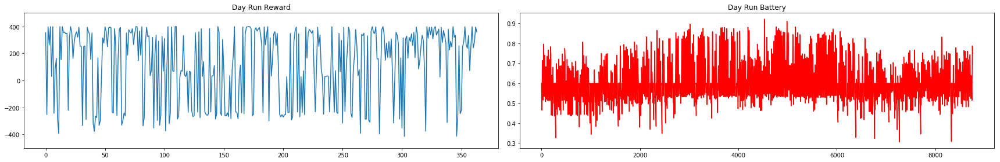


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  151.45832316860677


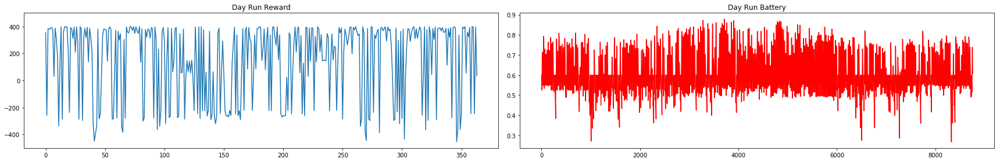


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  63.36569888190017


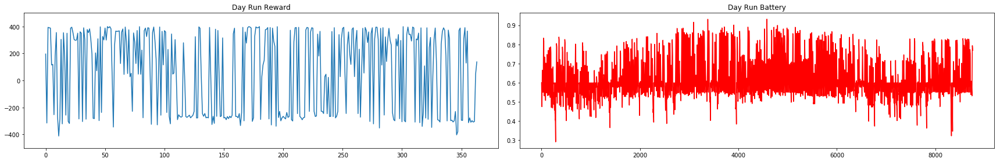


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  224.10741504482732


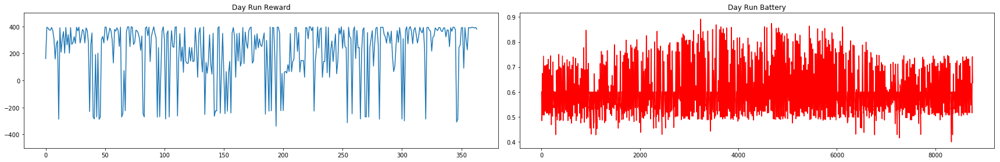


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  186.11473226665842


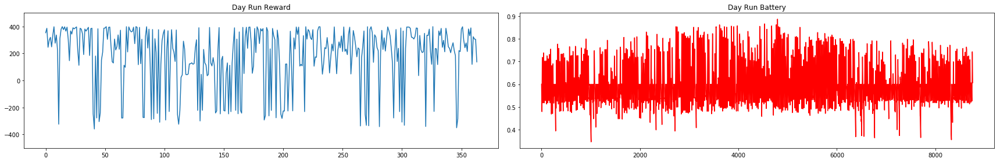


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  119.39225580390789


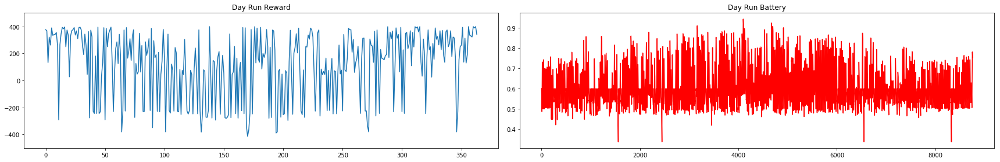


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  212.9904645205934


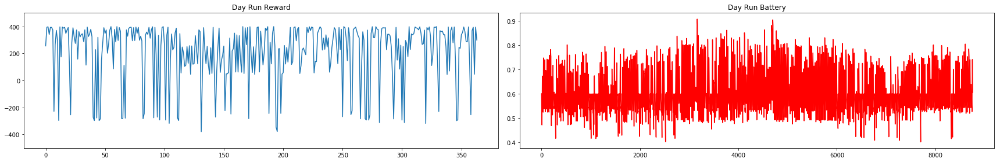


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  196.60462606675284


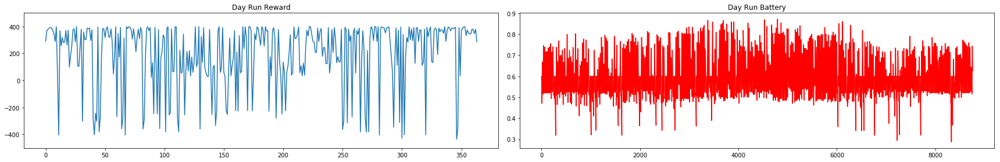


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  217.72323725547548


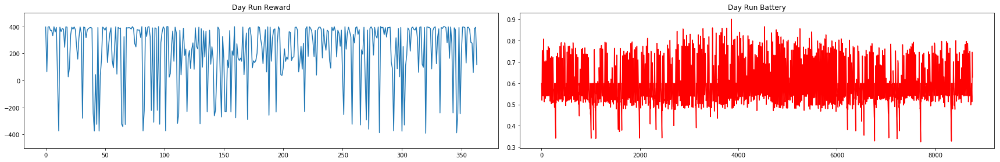


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  171.41019766922167


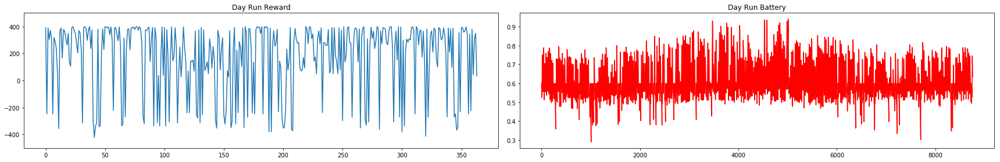


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  213.66220575632275


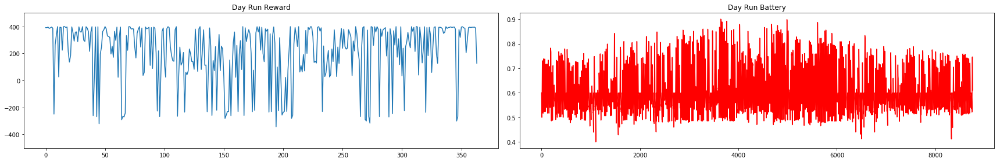


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  196.12733108893863


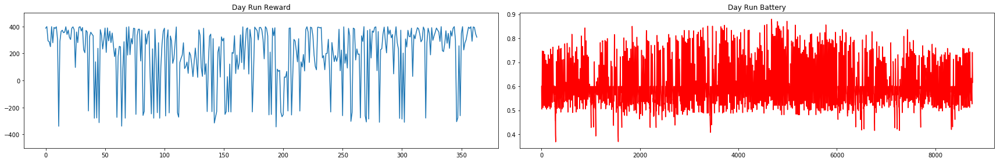


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  167.6547143495713


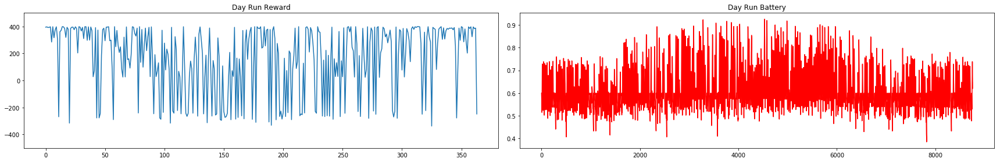


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  173.6759937350547


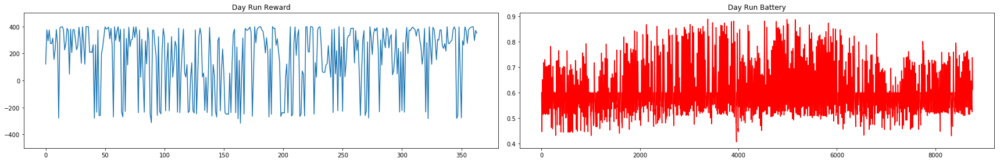


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  209.6193357180075


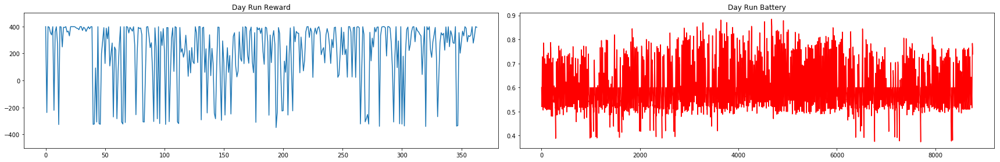


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  197.82443116060844


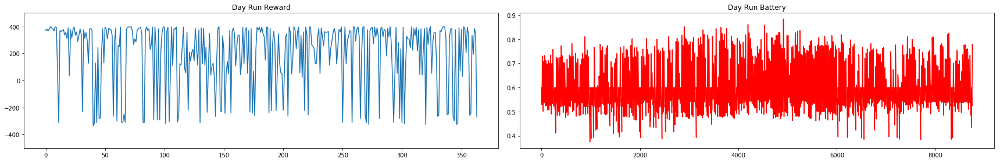


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  145.88450859560376


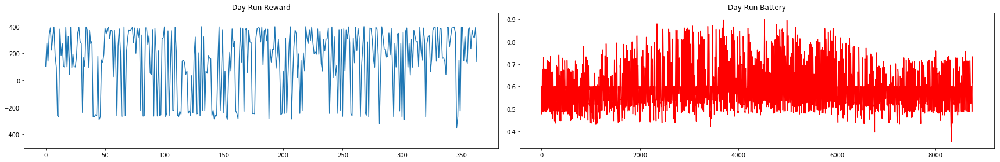


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  182.22204566557312


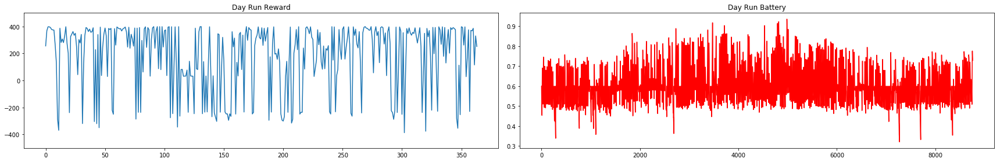


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  198.77530451268552


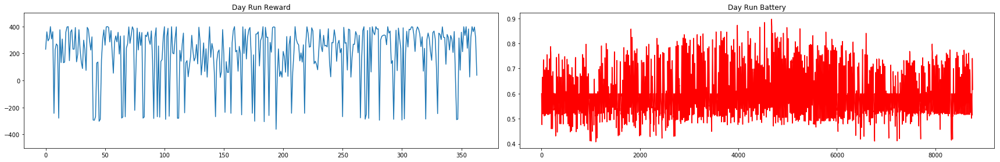


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  232.21620687354752


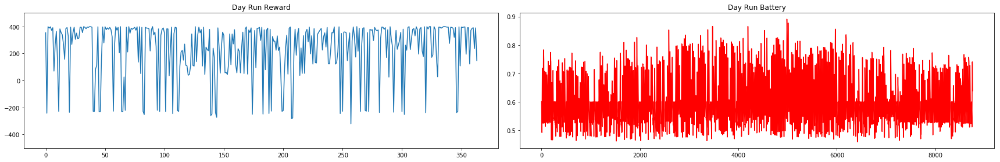


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  199.0318811416826


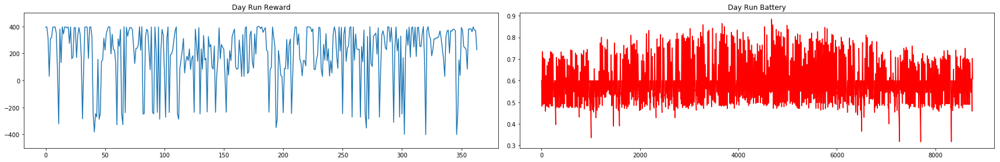


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  143.24224981290322


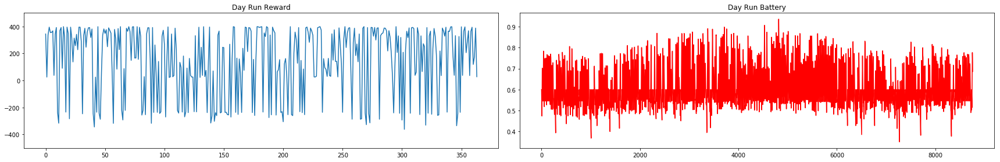


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  198.33543224860773


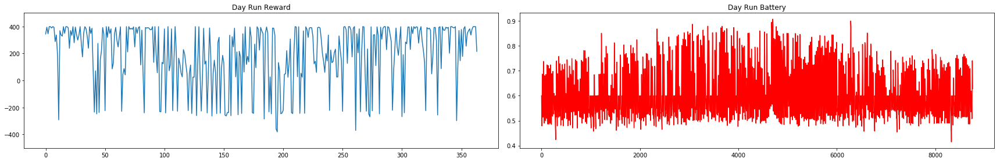


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  165.93212616160957


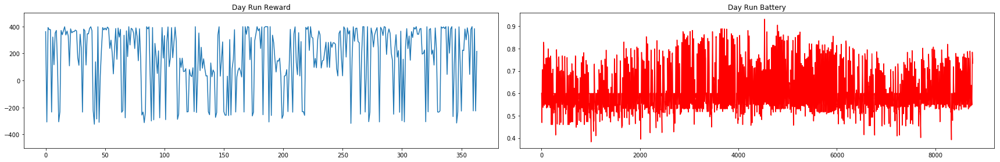


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  214.54136297612047


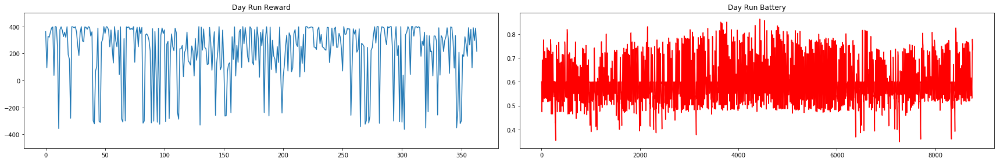


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  212.64583703018806


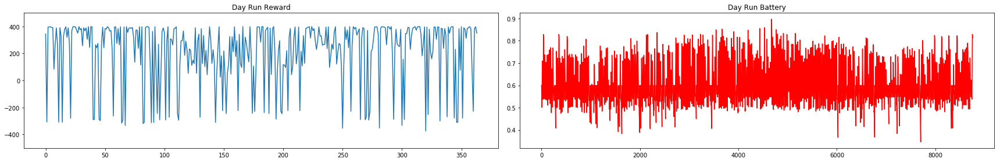


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  129.74233736332394


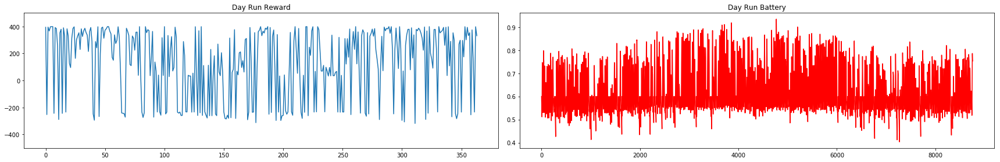


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  192.99984958177504


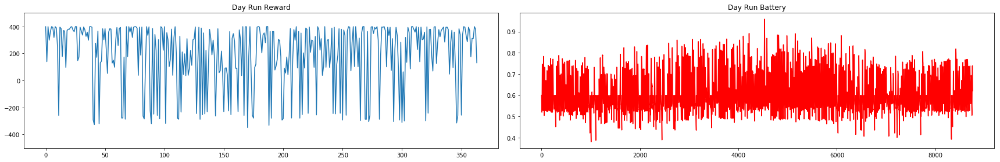


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  136.48471287765625


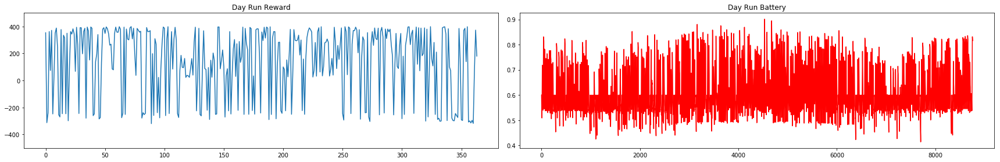


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  182.96501530266147


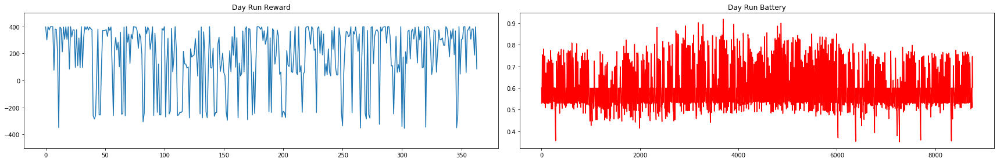


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  120.04560488192638


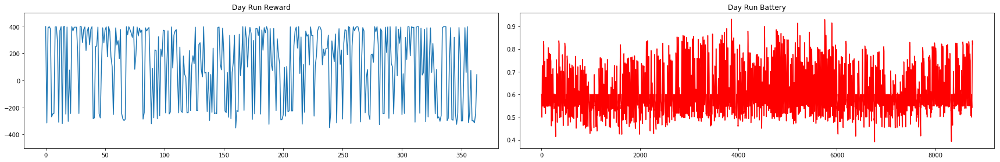


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  203.05325462368742


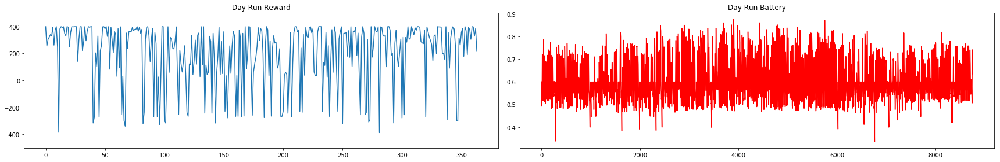


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  217.826800755301


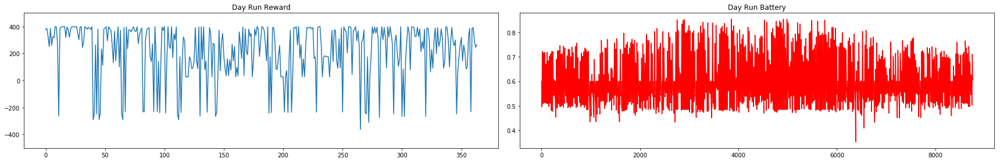


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  179.8887920437205


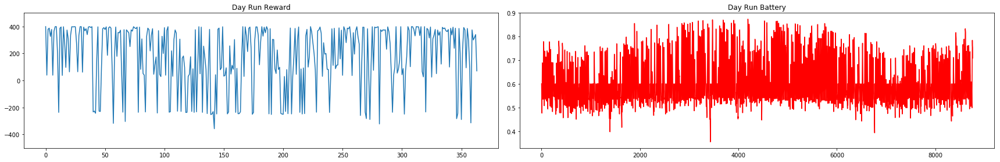


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  196.09151668131196


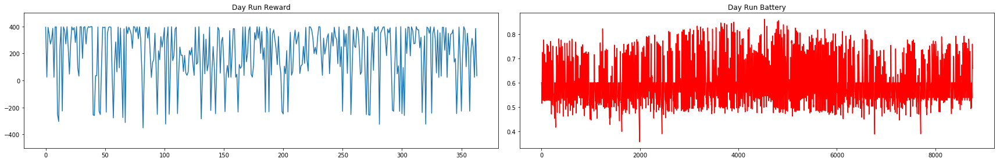


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  211.38173441458838


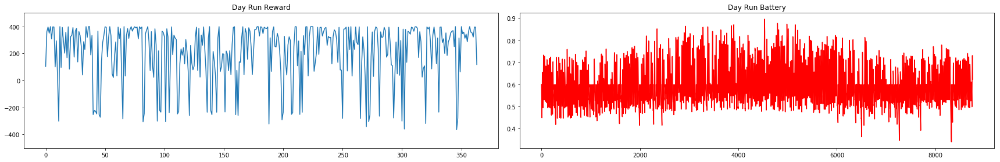


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  175.53108079644426


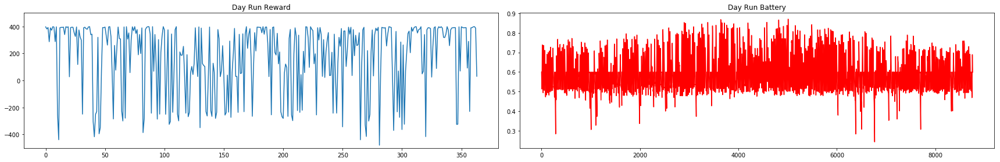


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  189.7751639300257


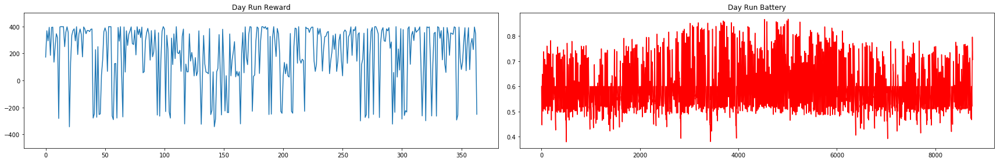


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  205.0562445800896


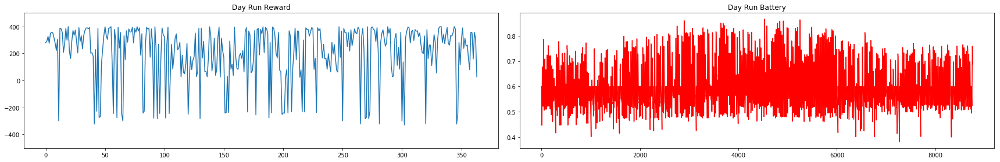


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  103.94028212590486


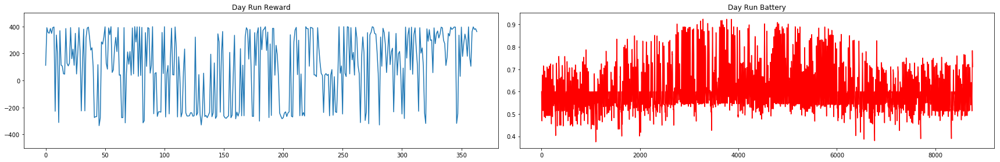


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  206.65377792968926


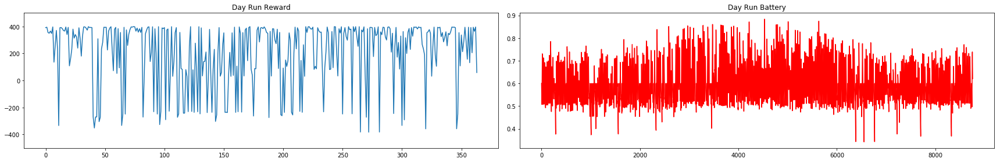


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  232.01390372988206


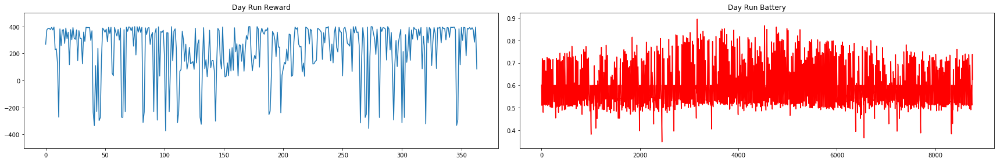


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  252.30835986950544


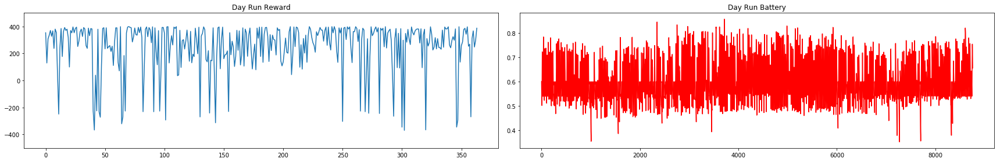


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  171.47547377055886


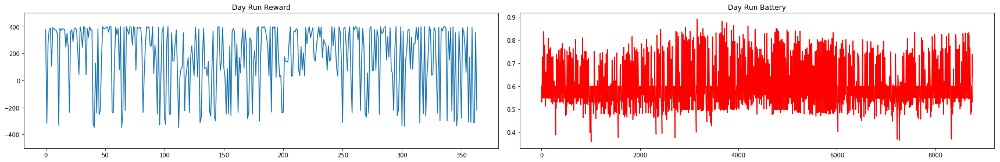


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  202.81630690556472


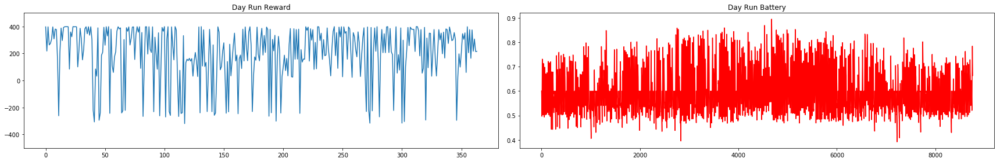


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  169.52216847789745


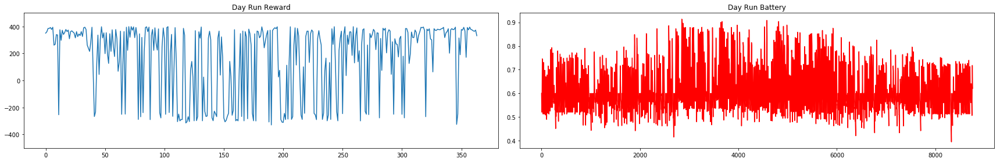


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  233.6476563554449


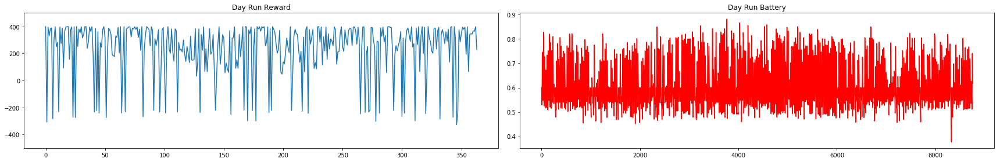


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  232.18041865821777


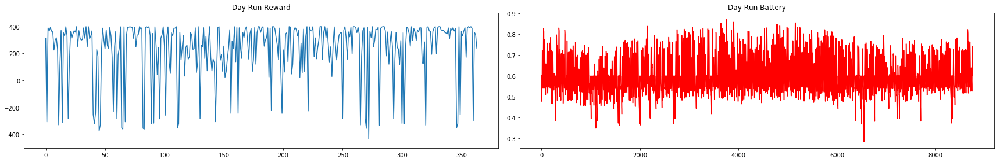


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  198.6243935226058


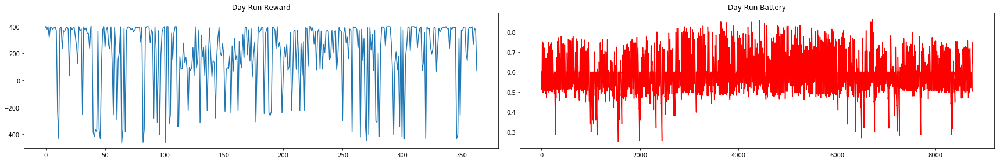


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  202.76006065792492


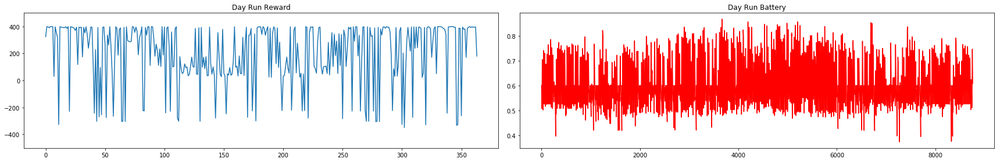


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  202.16522270797984


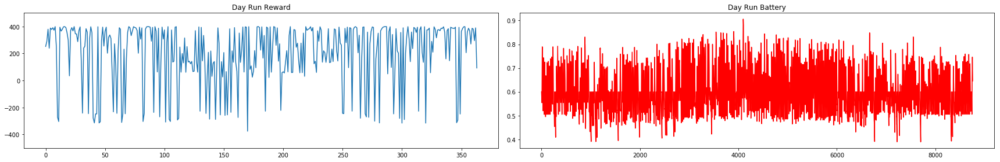


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  223.54726546254864


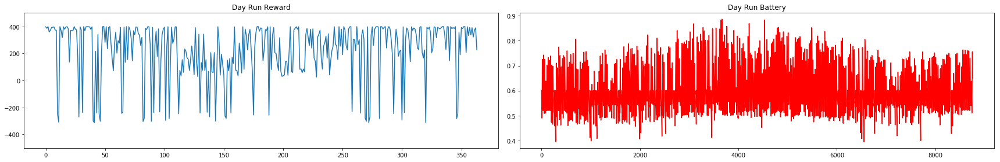


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  163.50979499083968


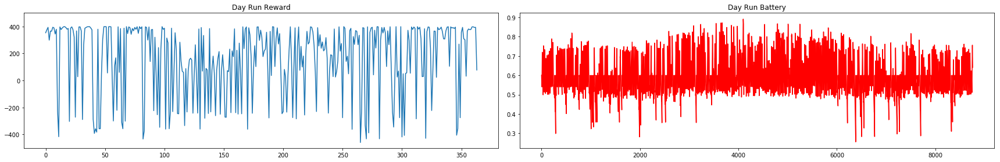


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  244.19794542087737


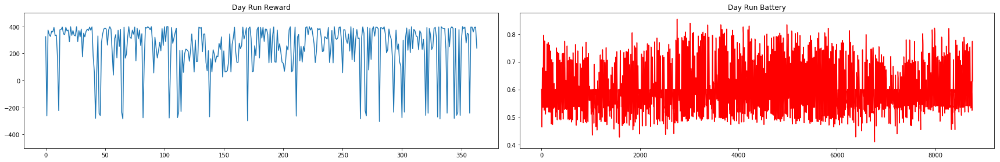


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  213.44877175299212


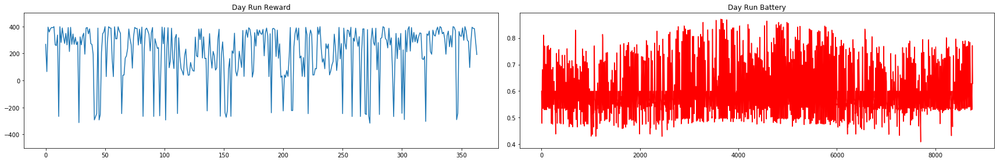


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  198.9741747535696


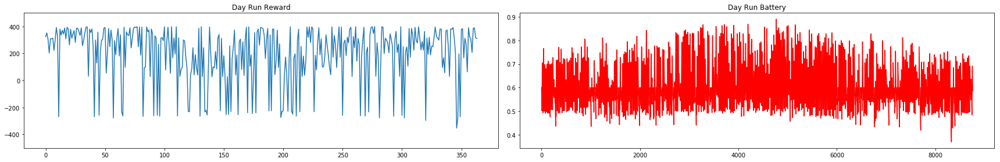


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  237.5931245540415


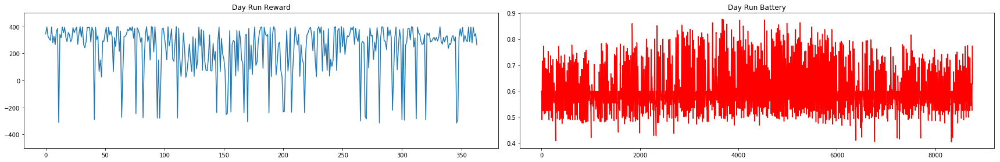


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  252.3936215334358


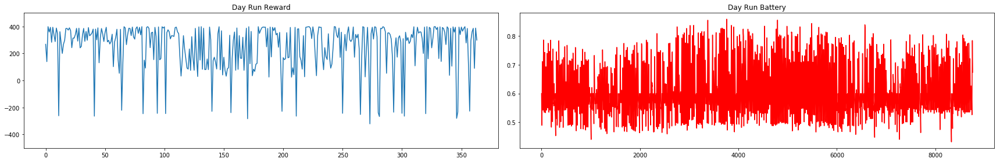


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  210.9754088895732


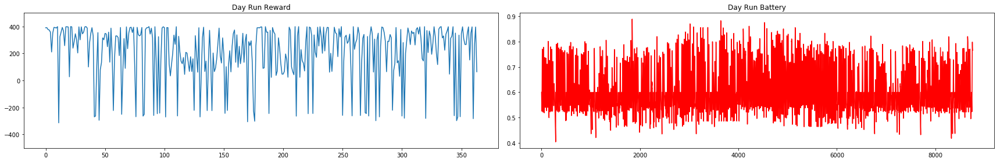


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  219.74274986286952


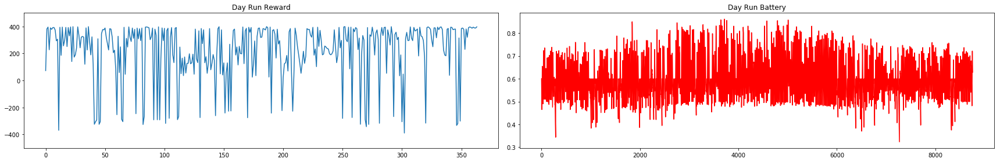


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  207.12834872676302


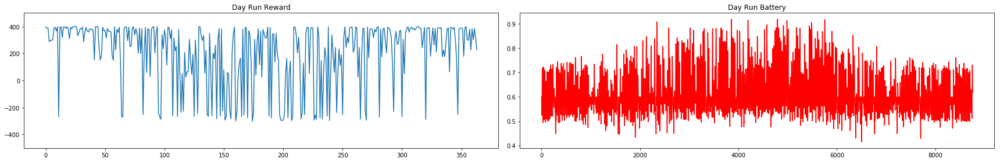


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  215.11791991017182


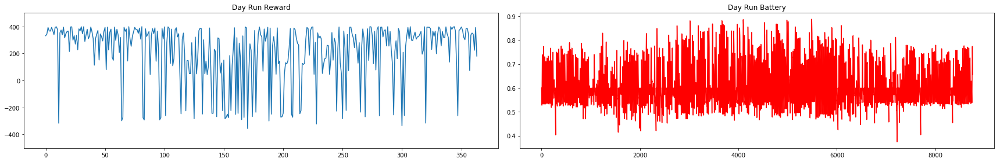


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  204.1878023882076


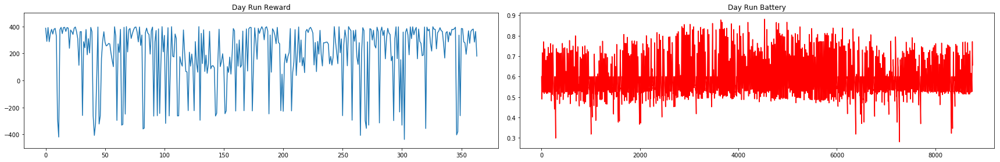


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  243.2073401692394


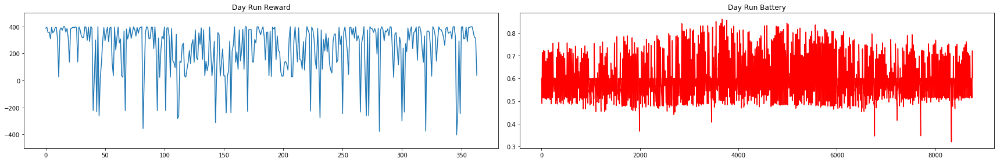


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  217.61438482728695


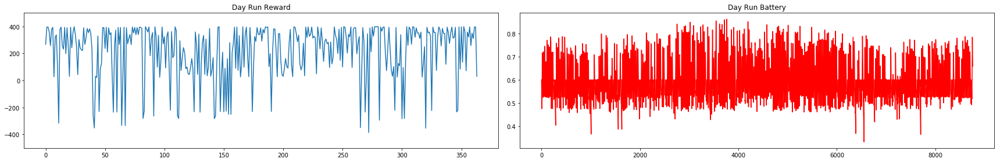


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  211.94161350968128


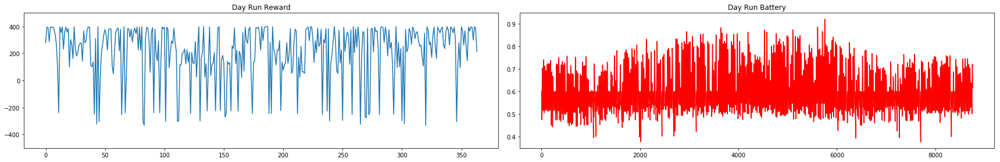


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  228.37836796605333


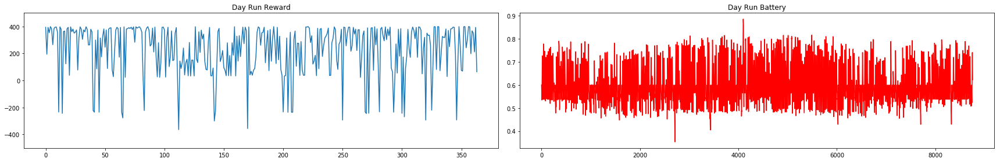


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  181.87314218652463


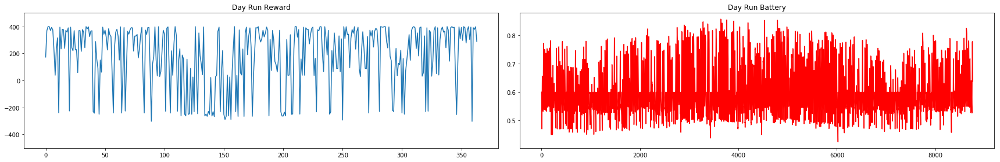


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  234.907196576048


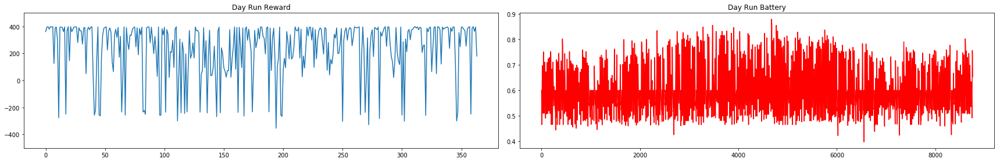


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  230.19293390339433


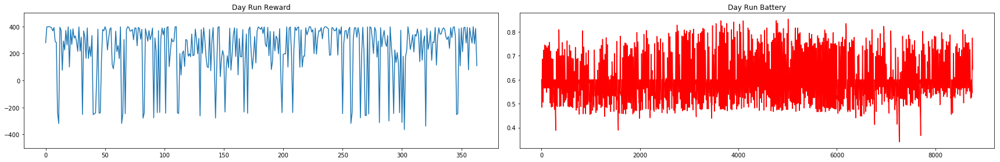


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  250.65637739858974


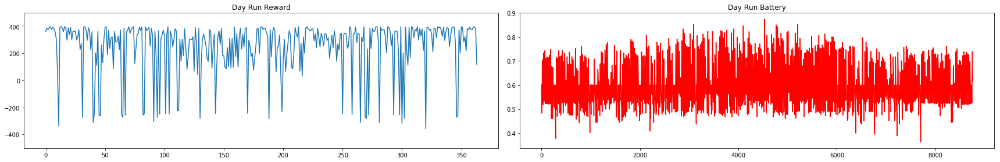


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  220.33202777348262


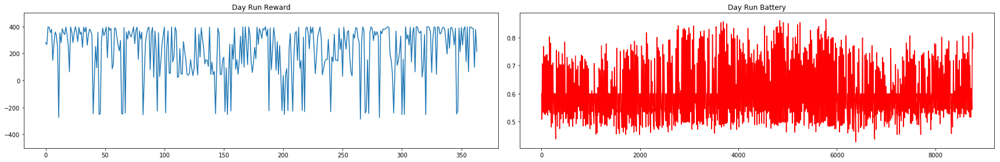


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  227.5982935358606


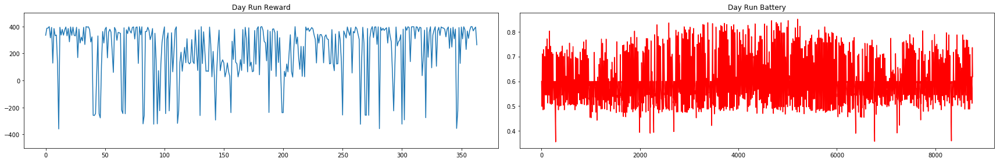


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  217.15209651039243


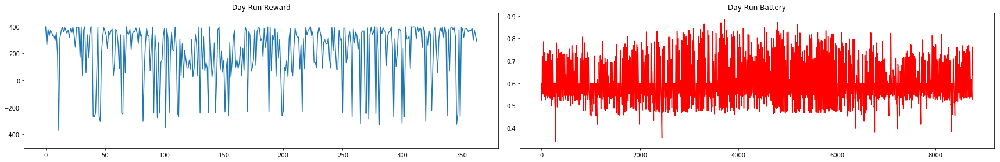


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  217.73955368466784


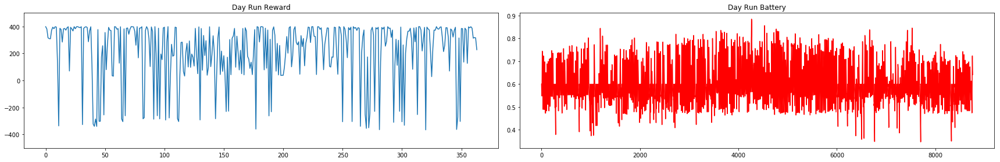


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  192.5975981534481


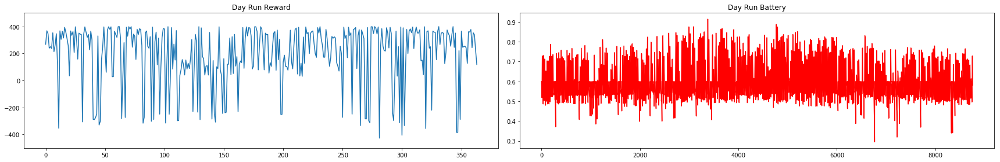


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  236.253464219692


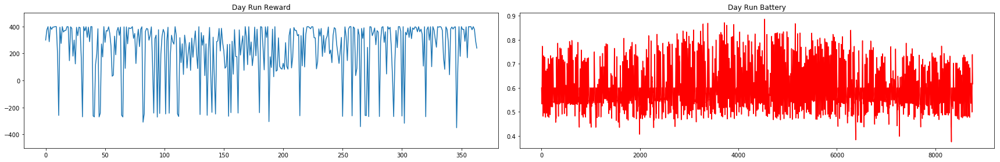


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  164.4123941870481


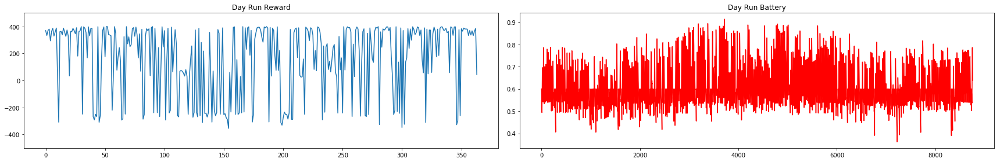


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  210.1864166642233


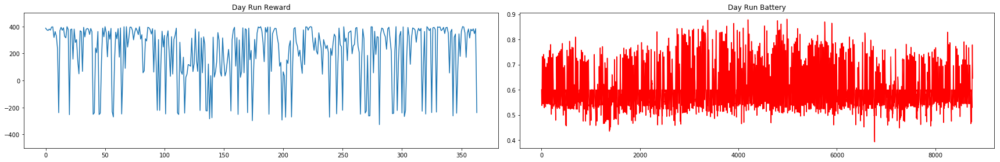


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  192.93520165887978


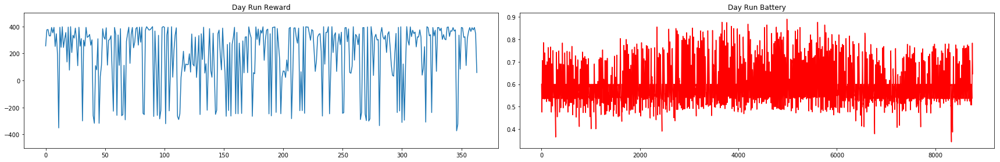


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  201.74783192349315


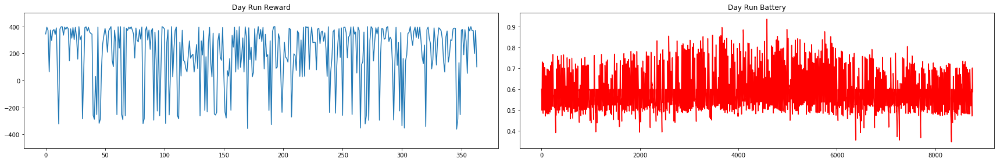


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  195.30295207273278


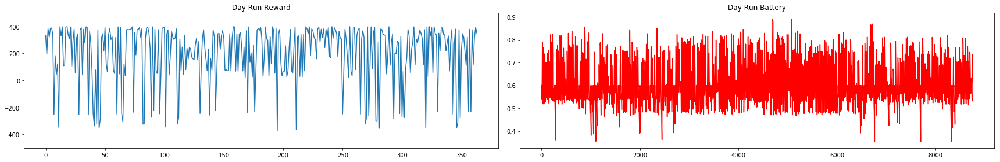


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  204.69171709851653


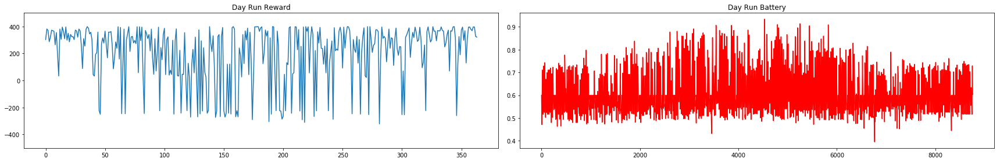


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  200.38773677428165


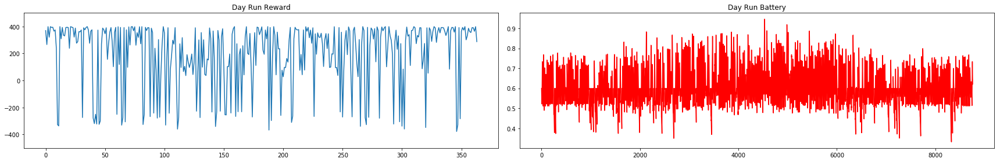


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  195.57490408258866


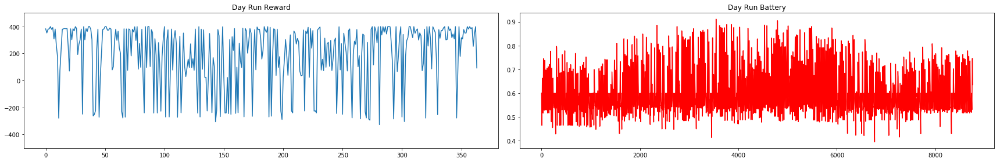


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  207.9387058256917


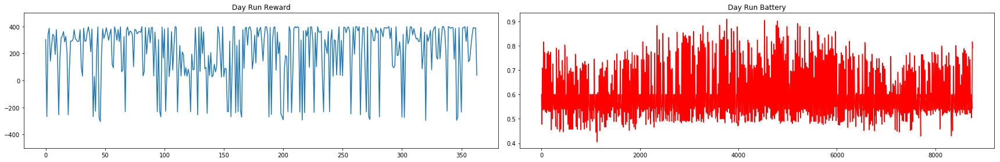


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  156.5775764991777


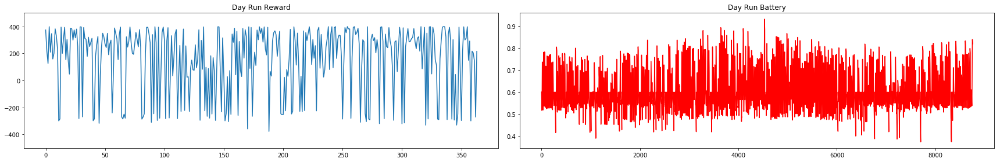


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  223.16021660335554


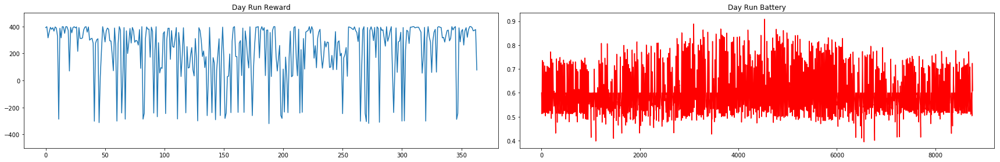


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  217.19829798017935


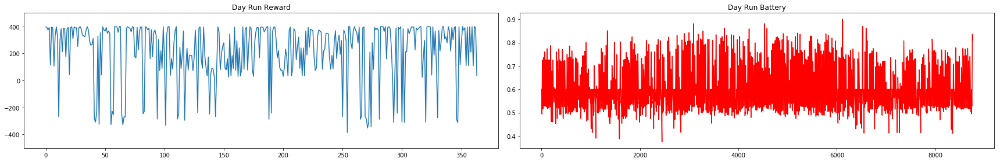


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  227.03635638362664


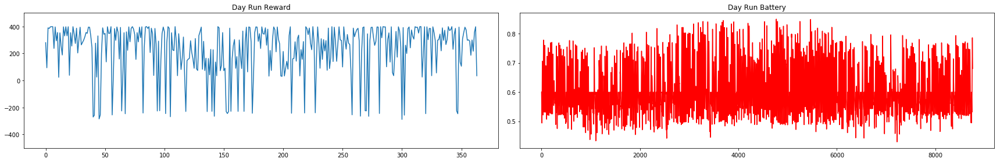


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  194.95606766653708


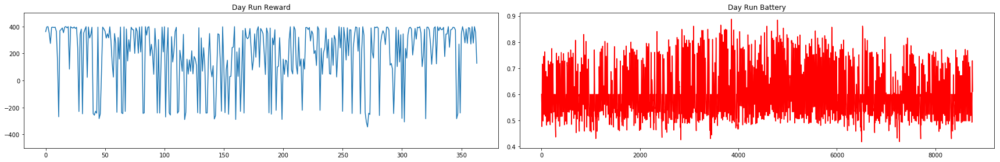


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  248.58777097461615


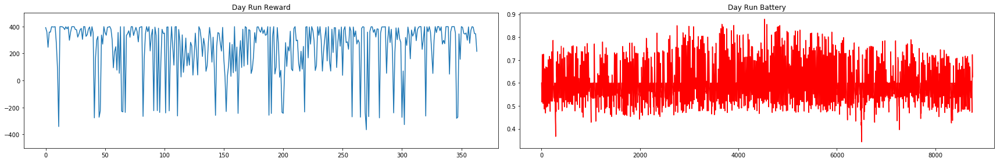


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  213.45040228932842


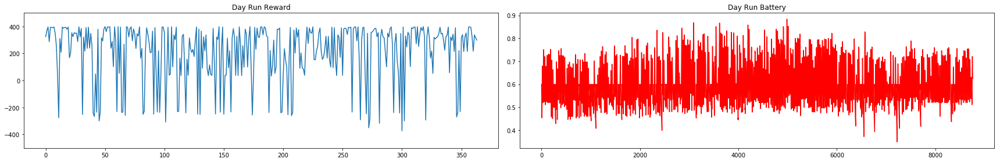


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  247.82464236976864


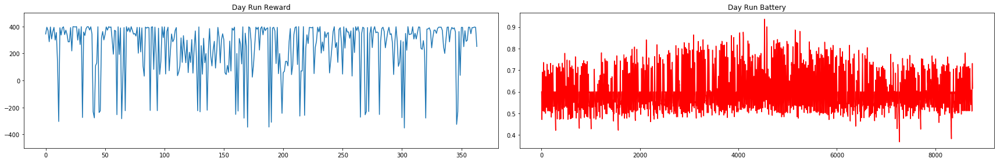


Learning Rate =  0.1
EPSILON =  0.7
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  229.74675799584728


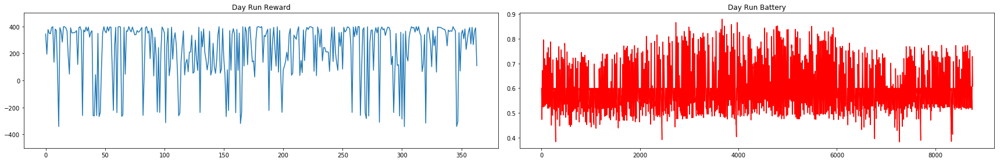


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  245.5671842614239


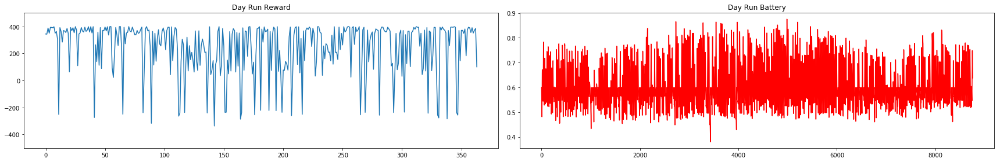


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  235.01321792364996


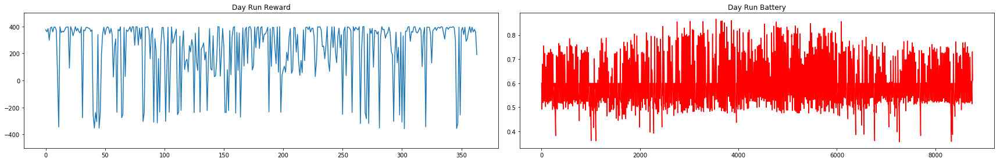


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  272.7265656953583


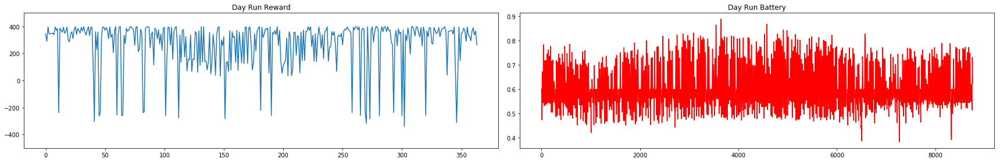


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  248.5521305297512


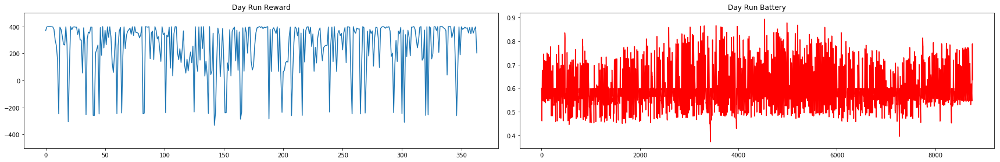


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  234.12982514882864


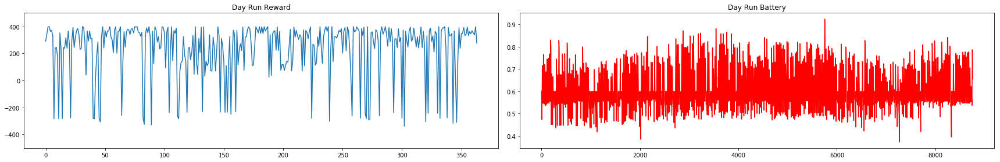


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  254.34357014316672


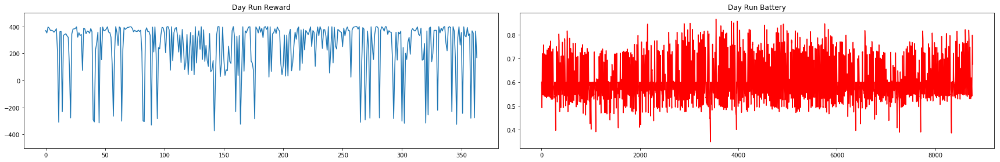


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  253.68088615594223


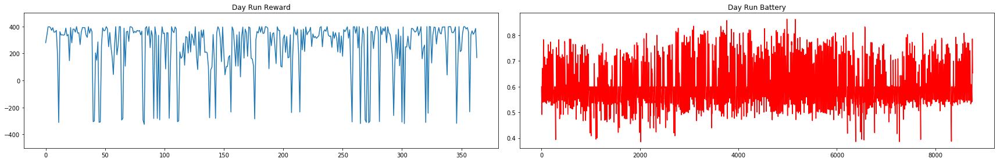


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  259.03314793360715


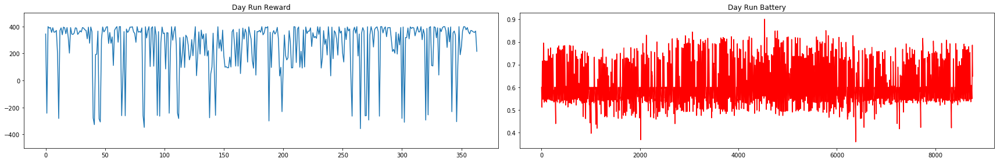


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  258.1640257738104


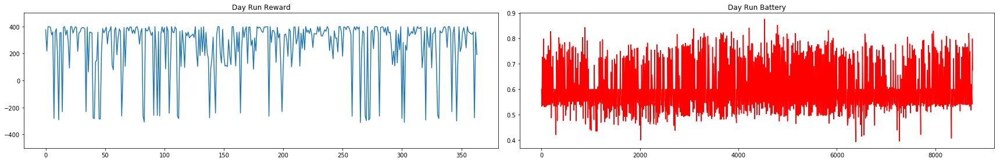


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  271.24344658711385


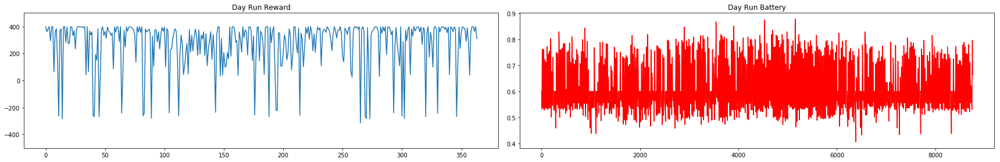


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  253.6400379284916


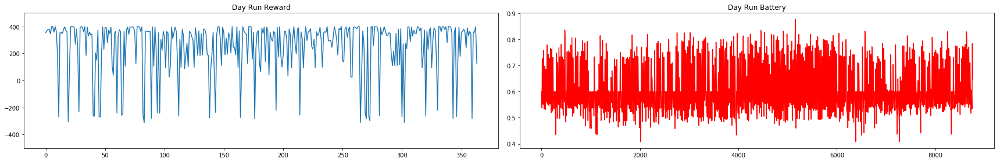


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  252.48918407161858


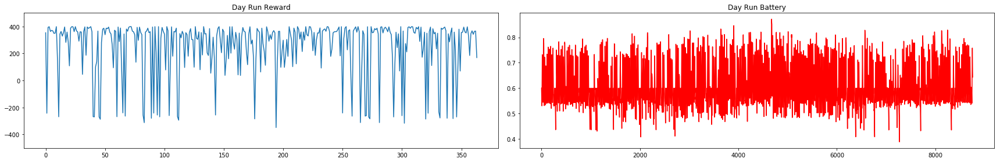


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  270.792827612171


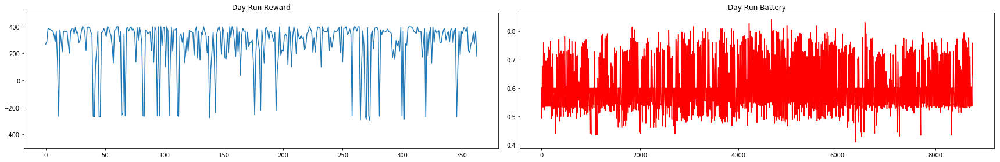


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  267.7092344541997


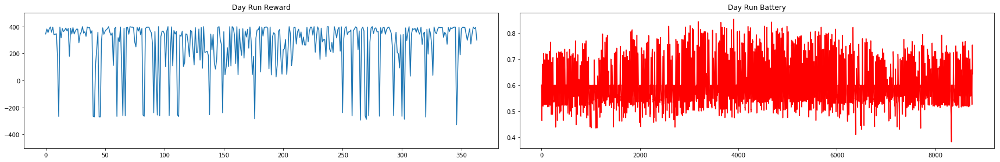


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  281.7667695580127


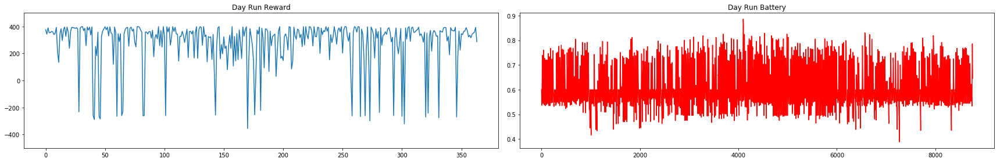


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  287.79426644863656


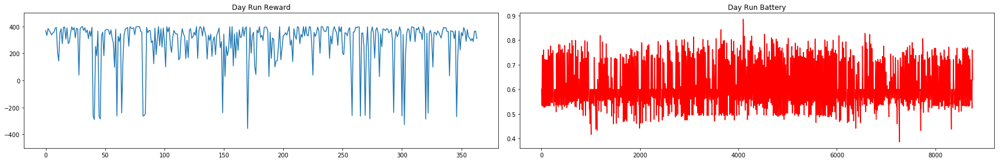


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  296.1755935864159


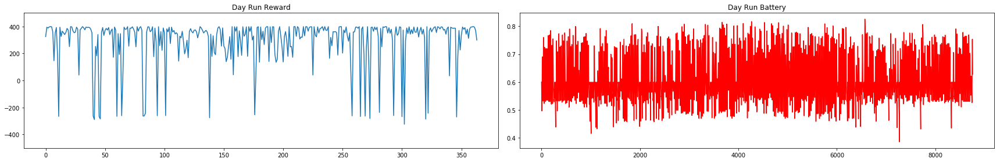


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  288.0680252866729


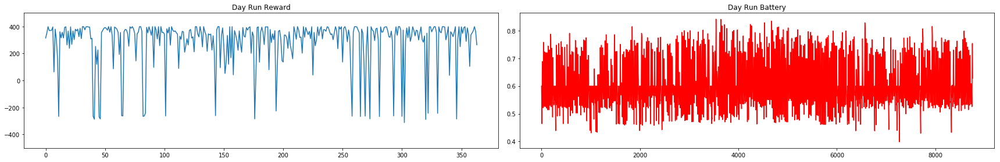


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  250.08207998612284


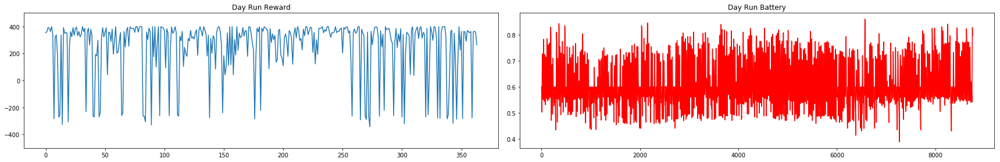


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  289.00912746422347


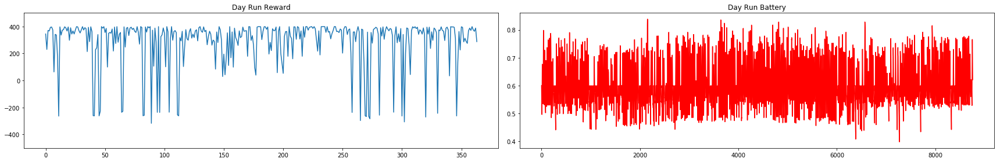


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  259.3664061461633


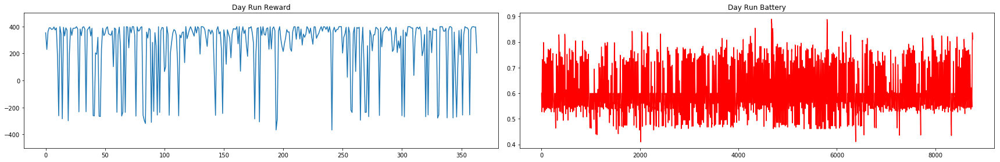


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  268.17039980769874


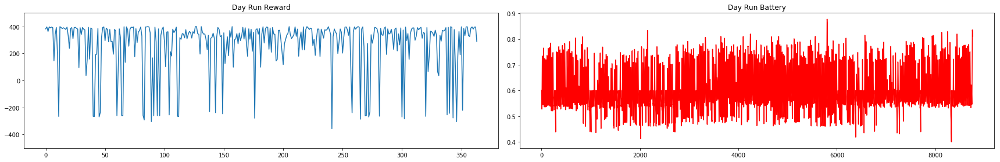


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  247.326269032912


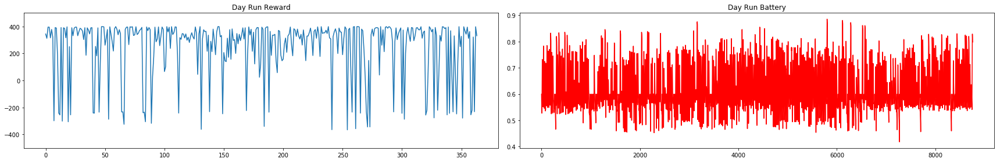


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  254.95642038962666


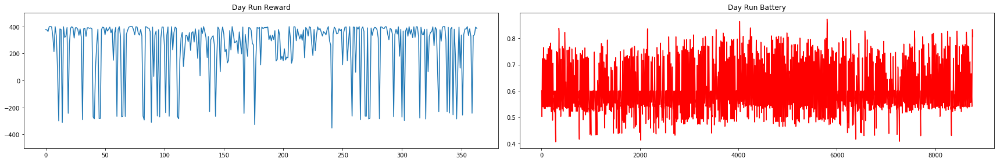


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  255.5375039075626


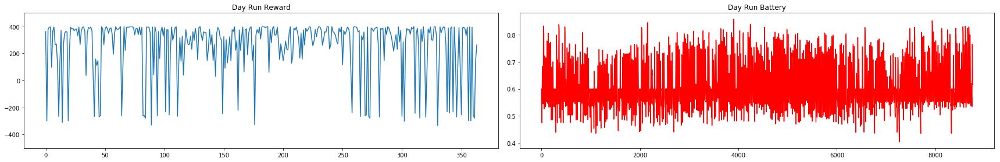


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  258.3231739136443


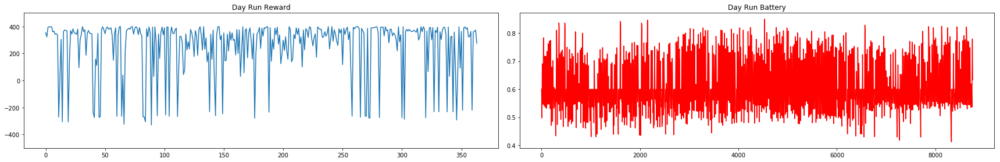


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  254.34627663377506


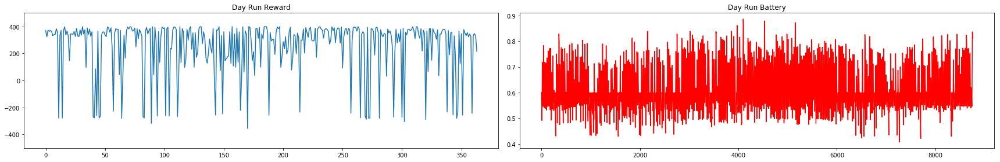


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  257.9940162523066


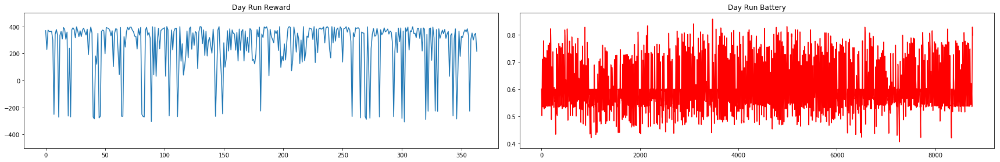


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  239.53670127553858


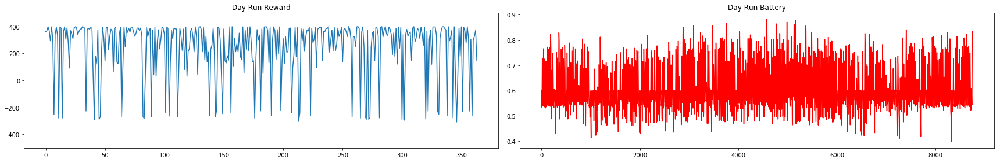


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  196.95852065633133


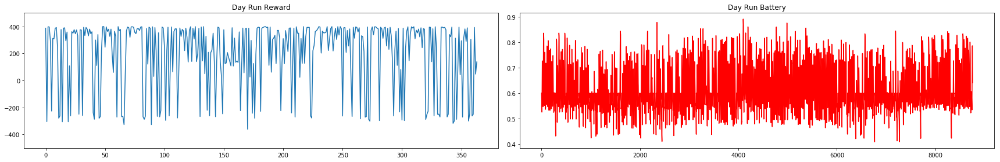


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  207.85088568591485


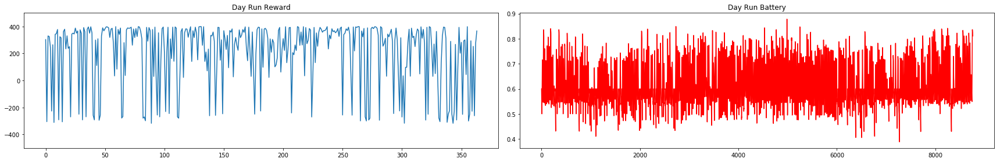


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  255.90527827308472


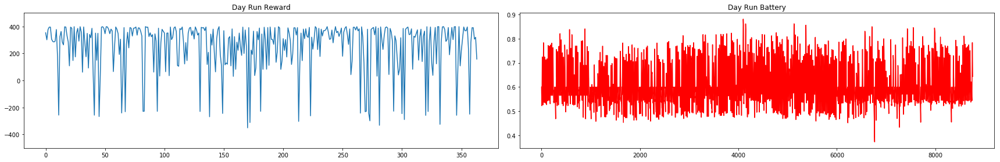


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  269.69333939790044


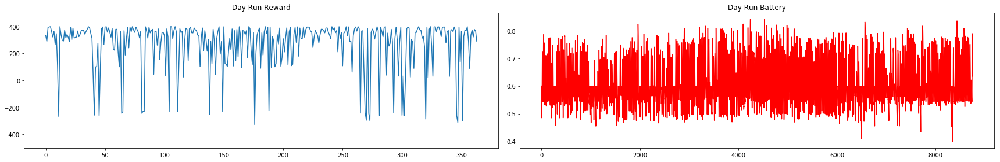


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  259.2445305234564


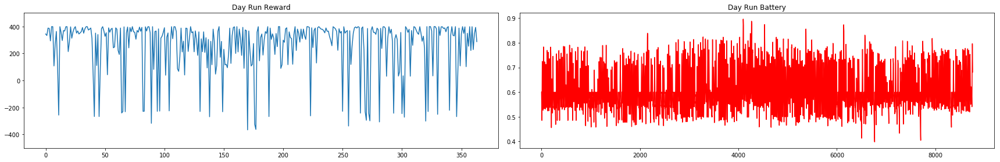


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  296.7356222982088


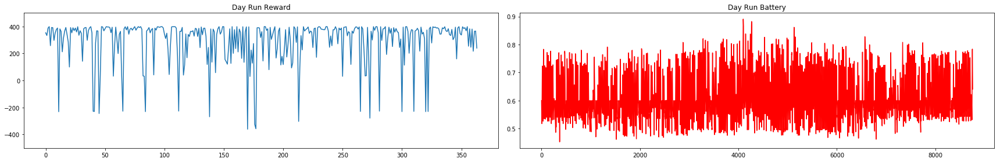


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  247.5325277503151


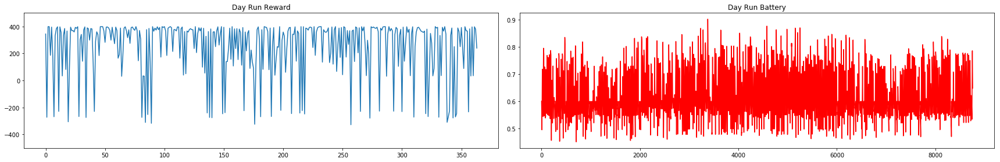


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  290.34712095081875


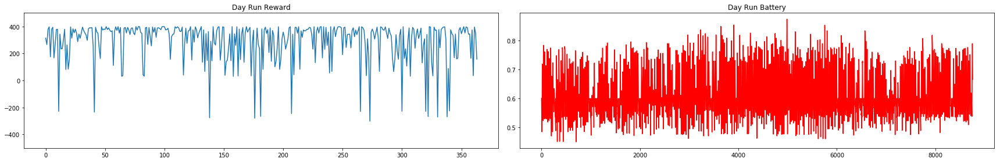


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  263.7516203973989


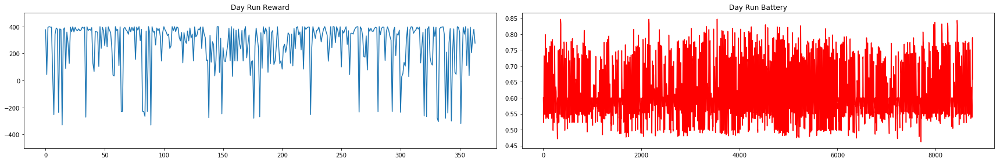


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  273.9927485640082


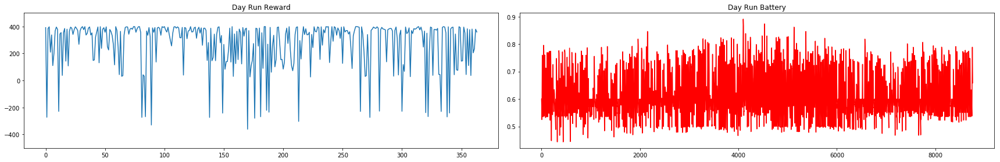


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  253.6841017945165


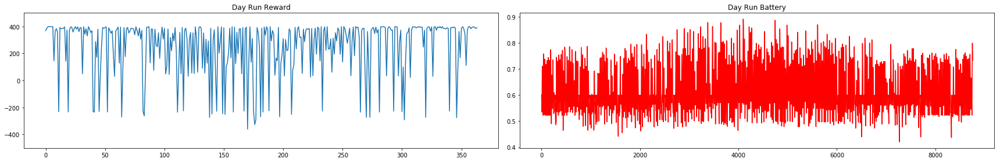


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  255.52001893022177


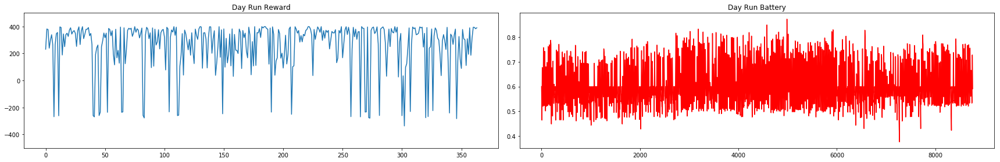


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  243.45726869340913


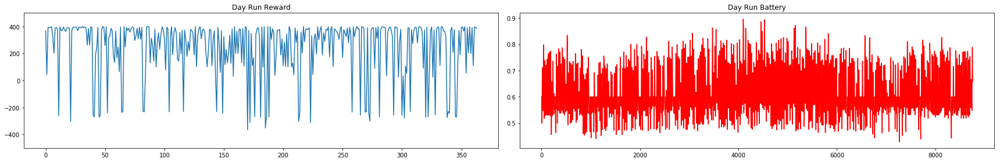


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  226.1450470304902


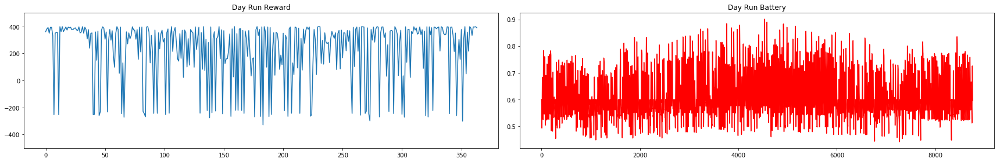


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  220.3209932261557


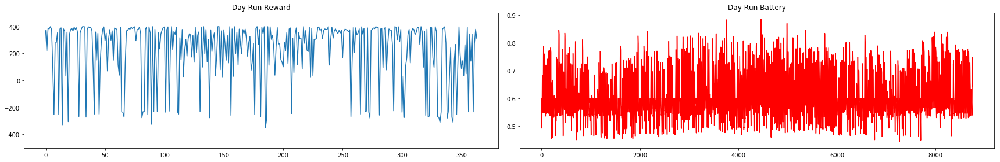


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  233.62255518938363


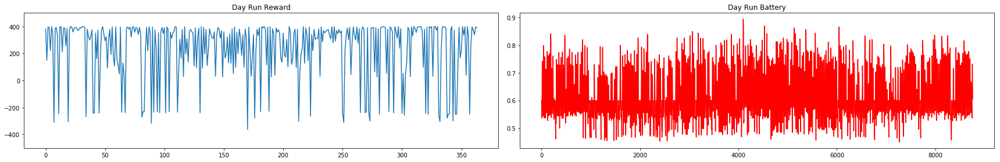


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  181.91498458414554


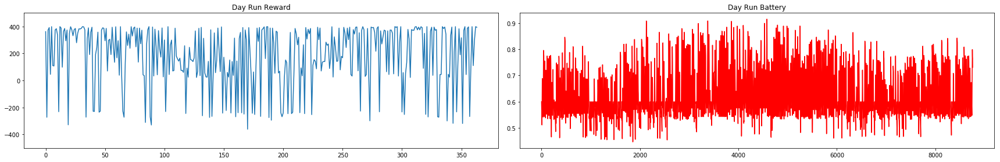


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  234.58193835484434


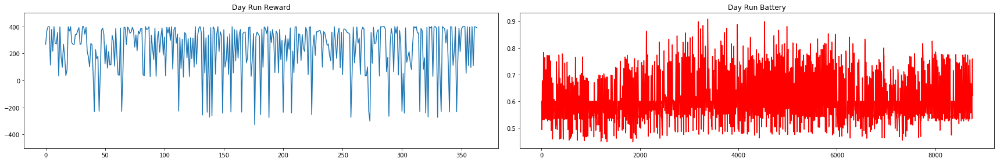


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  178.22793727697382


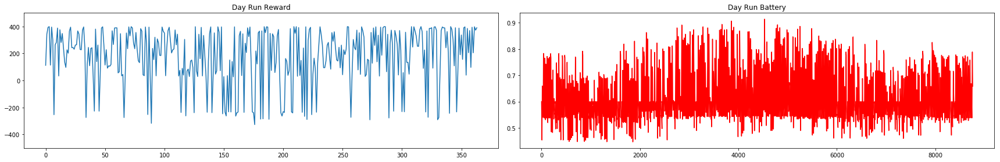


Learning Rate =  0.02
EPSILON =  0.9
Environment is RESET
End of Year

Day run test
Environment is RESET
End of Year
Average Reward:  233.66159532558328


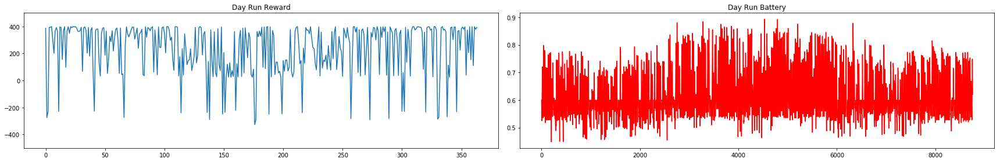

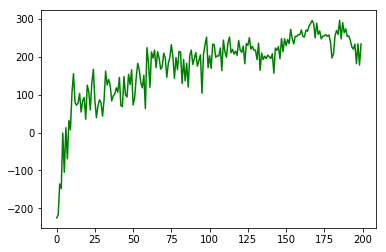

In [8]:
NO_OF_ITERATIONS = 200
avg_reward_rec = np.empty(1)

for iteration in range(NO_OF_ITERATIONS):
    if (50< iteration <= 150):
        LR = 0.1                   # learning rate
        EPSILON = 0.7              # greedy policy
    elif (150<iteration<=NO_OF_ITERATIONS):
        LR = 0.02
        EPSILON = 0.9
    else:
        LR = 0.2
        EPSILON = 0.7
    
    ############################################################################################
    #LEARN BY RESETTING BATTERY EVERYDAY
    print('\nCollecting experience... Iteration:', iteration)
    print('Learning Rate = ', LR)
    print('EPSILON = ', EPSILON)

    ps, r, done, info = eno.reset()
    while True:
        s = sarsa.discretize(ps)
        a = sarsa.choose_action(s)
        ns, r, done, info = eno.step(a)

        if eno.hr == 0: #flag to let the sarsa algorithm know that the reward has been obtained
            terminal = True
            eno.batt = eno.BOPT
            ns = eno.getstate()
        else:
            terminal = False
        
        s_ = sarsa.discretize(ns)
        a_ = sarsa.choose_action(s_)        
        transition = [s,a,r,s_,a_]
        
        sarsa.learn(transition,terminal)
        if done:
            print("End of Year")
            break

        ps = ns
    
    ############################################################################################
    #TEST
    print('\nDay run test')
    ps, r, done, info = eno.reset()
    yr_test_record = np.empty(4)

    while True:
        s = sarsa.discretize(ps)
        a = sarsa.choose_greedy_action(s)

        yr_test_record = np.vstack((yr_test_record, [ps[0],ps[2],r, a])) #record battery, henergy, reward and action

        ns, r, done, info = eno.step(a)

            
        if eno.hr == 0: #flag to let the sarsa algorithm know that the reward has been obtained
            eno.batt = eno.BOPT
            ns = eno.getstate()

        s_ = sarsa.discretize(ns)
        a_ = sarsa.choose_action(s_)        

        if done:
            print("End of Year")
            break

        ps = ns

    yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage
    yr_test_reward_rec = yr_test_record[:,2]
    yr_test_reward_rec = yr_test_reward_rec[yr_test_reward_rec != 0]
    print("Average Reward: ", np.mean(yr_test_reward_rec))
    avg_reward_rec = np.append(avg_reward_rec, np.mean(yr_test_reward_rec))


    ############################################################################################
    #PLOT
    fig = plt.figure(figsize=(24,4))
    ax1 = fig.add_subplot(121)
    ax1.plot(yr_test_reward_rec)
    ax1.set_title("Day Run Reward")
    ax1.set_ylim([-500,500])

    ax2 = fig.add_subplot(122)
    ax2.plot(yr_test_record[:,0],'r')
    ax2.set_title("Day Run Battery")
    # ax2.set_ylim([0,1])

    fig.tight_layout()
    plt.show()

#PLOT THE AVERAGE REWARD OVER THE ITERATIONS
avg_reward_rec = np.delete(avg_reward_rec, 0, 0) #remove the first row which is garbage
plt.plot(avg_reward_rec,'g')

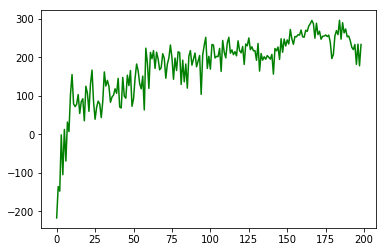

In [9]:
avg_reward_rec = np.delete(avg_reward_rec, 0, 0) #remove the first row which is garbage
fig2 = plt.figure()
plt.plot(avg_reward_rec,'g')

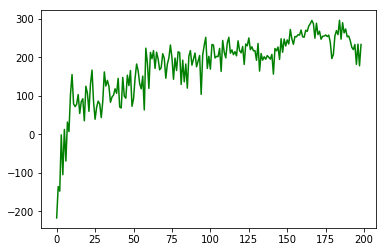

In [10]:
plt.plot(avg_reward_rec,'g')

In [11]:
avg_reward_rec

array([-217.54762383, -135.97345851, -147.8573056 ,   -1.48395293,
       -105.14276707,   12.6069216 ,  -69.6066979 ,   31.94147481,
          7.01656934,  105.13829562,  155.43729854,   79.15263172,
         71.93904646,   78.26613206,  103.38740601,   54.21192607,
         84.78046305,   92.4580032 ,   35.12331542,  125.09559671,
        106.87905106,   59.68925306,  131.08332256,  167.01054951,
         83.98642413,   39.18998539,   70.58105966,   86.26846019,
         79.08882551,   43.39758226,   86.44256894,  162.33920147,
        125.61081198,  140.30739931,  124.82822524,   83.42435317,
         97.05703328,  102.03225185,  118.3115285 ,  106.62965022,
        145.49863025,   70.88882224,   68.50086495,  147.97950069,
         99.19435502,   93.90552412,  153.72284693,  126.65574886,
        165.83653486,   72.83976537,   91.91208795,  145.55472049,
        182.87944052,  165.40307402,  131.66126019,  118.33994549,
        151.45832317,   63.36569888,  224.10741504,  186.11473

In [12]:
# # Verifying learned Q-table over a year
# print('\nYear run test')
# ps, r, done, info = eno.reset()
# yr_test_record = np.empty(4)

# while True:
#     s = sarsa.discretize(ps)
#     a = sarsa.choose_greedy_action(s)
    
# #     print("\nBatt: ", eno.batt)
# #     print("Henergy: ", eno.henergy)
# #     print("Action: ", (a+1)/10*DMAX)

#     yr_test_record = np.vstack((yr_test_record, [ps[0],ps[2],r, a])) #record battery, henergy, reward and action
# #     print("**************")
# #     print("Batt: ", ps[0])
# #     print("Henergy: ", ps[2])
# #     print("Action: ", a)


#     ns, r, done, info = eno.step(a)
    
#     if eno.hr == 0: #flag to let the sarsa algorithm know that the reward has been obtained
#         terminal = True
#     else:
#         terminal = False
    
#     s_ = sarsa.discretize(ns)
#     a_ = sarsa.choose_action(s_)        
# #     transition = [s,a,r,s_,a_]

# #     sarsa.learn(transition,terminal)
#     if done:
#         print("End of Year")
#         break

#     ps = ns

# yr_test_record = np.delete(yr_test_record, 0, 0) #remove the first row which is garbage

In [13]:
# yr_test_reward_rec = yr_test_record[:,2]
# yr_test_reward_rec = yr_test_reward_rec[yr_test_reward_rec != 0]

# day_test_reward_rec = day_test_record[:,2]
# day_test_reward_rec = day_test_reward_rec[day_test_reward_rec != 0]


# fig = plt.figure(figsize=(24,4))
# ax1 = fig.add_subplot(221)
# ax1.plot(yr_test_reward_rec)
# ax1.set_title("Year Run Reward")
# # ax1.set_ylim([-400,400])

# ax2 = fig.add_subplot(222)
# ax2.plot(yr_test_record[:,0],'r')
# ax2.set_title("Year Run Battery")
# # ax2.set_ylim([0,1])

# ax3 = fig.add_subplot(223)
# ax3.plot(day_test_reward_rec)
# ax3.set_title("Day Run Reward")
# # ax3.set_ylim([-400,400])

# ax4 = fig.add_subplot(224)
# ax4.plot(day_test_record[:,0],'r')
# ax4.set_title("Day Run Battery")
# # ax4.set_ylim([0,1])

# fig.tight_layout()

In [14]:
# TIME_AXIS = np.arange(0,eno.TIME_STEPS)
# for DAY in range(eno.NO_OF_DAYS):
#     START = DAY*24
#     END = START+24

#     fig = plt.figure(figsize=(16,4))
#     st = fig.suptitle("DAY %s" %(DAY))

#     ax2 = fig.add_subplot(131)
#     ax2.plot(yr_test_record[START:END,1],'g')
#     ax2.set_title("Harvested Energy")
#     plt.xlabel("Hour")
#     ax2.set_ylim([0,1.2])

#     #plot battery for year run
#     ax1 = fig.add_subplot(132)
#     ax1.plot(TIME_AXIS,yr_test_record[START:END,0],'r') 
#     ax1.plot(TIME_AXIS, np.ones(eno.TIME_STEPS)*eno.BOPT/eno.BMAX,'r--')
#     ax1.set_title("YEAR RUN")
#     if END < (eno.NO_OF_DAYS*eno.TIME_STEPS):
#         ax1.text(12, 0, "REWARD = %.2f\n" %(yr_test_record[END,2]),fontsize=11, ha='center')
#     plt.xlabel("Hour")
#     ax1.set_ylabel('Battery', color='r',fontsize=12)
#     ax1.set_ylim([0,1.2])

#     #plot actions for year run
#     ax1a = ax1.twinx()
#     ax1a.plot(yr_test_record[START:END,3])
#     ax1a.set_ylim([0,N_ACTIONS])
#     ax1a.set_ylabel('Duty Cycle', color='b',fontsize=12)

    
    
#     #plot battery for day run
#     ax3 = fig.add_subplot(133)
#     ax3.plot(TIME_AXIS,day_test_record[START:END,0],'r') 
#     ax3.plot(TIME_AXIS, np.ones(eno.TIME_STEPS)*eno.BOPT/eno.BMAX,'r--')
#     ax3.set_title("DAY RUN")
#     if END < (eno.NO_OF_DAYS*eno.TIME_STEPS):
#         ax3.text(12, 0, "REWARD = %.2f\n" %(day_test_record[END,2]),fontsize=11, ha='center')
#     plt.xlabel("Hour")
#     ax3.set_ylabel('Battery', color='r',fontsize=12)
#     ax3.set_ylim([0,1.2])
    
#     #plot actions for day run
#     ax3a = ax3.twinx()
#     ax3a.plot(day_test_record[START:END,3])
#     ax3a.set_ylim([0,N_ACTIONS])
#     ax3a.set_ylabel('Duty Cycle', color='b',fontsize=12)

#     fig.tight_layout()
#     st.set_y(0.95)
#     fig.subplots_adjust(top=0.75)
#     plt.show()